# Overview

- Using the same setup as V vs. B testing and V vs. Temp
- With same probe in place, run temperature schedule (14 deg C - 30 deg C, 2 deg C steps) for several magnet currents
- Do a multidimensional fit of |V| vs. B, Temp
    - Polynomial of n and m degrees
    - Try with Chebyshev polynomials
- For each current:
    - Run temperature schedule
    - $>=4$ hours to cool back to 14 deg C + magnet current change settles
- Slow controls (main): 5 seconds between measurements, Hall probe, NMR, magnet current + voltage, Zaber readout, SmarAct readout
- Slow controls (temperatures): read out all slow control temperature probes every 3 minutes

# Imports

In [2]:
from IPython.display import display, HTML
display(HTML("<style>.container { width:100% !important; }</style>"))

In [3]:
import numpy as np
import pandas as pd
import pickle as pkl
from datetime import datetime
from datetime import timedelta
from pandas.api.types import is_numeric_dtype
from scipy.interpolate import interp1d
from scipy.optimize import fsolve
import lmfit as lm
from copy import deepcopy
#from dateutil import parser
from plotly import graph_objects as go
from plotly.offline import plot
import matplotlib.pyplot as plt
from matplotlib.ticker import AutoMinorLocator
%matplotlib inline

# local imports
from plotting import config_plots, datetime_plt
from load_slow import *
from Zaber_Magnet_Convert import *
# hallprobecalib package
from hallprobecalib.hpcplots import scatter3d, scatter2d, histo
from mu2e.mu2eplots import mu2e_plot3d

In [4]:
config_plots()

In [5]:
ddir = '/home/ckampa/Dropbox/LogFiles/'
pkldir = '/home/ckampa/data/hallprobecalib_extras/datafiles/V_vs_B_T/'

In [6]:
# 7-21-21 12:58, probe 8, temperature effects -- using cooling schedule on PGC control software
# 12 deg C to 30 deg C, 1 deg step. Ramp 1 deg over 10 min, dwell for 30 min.
# After last step, ramp down to 12 deg C in 5 seconds, dwell for 3 hr 30 min to restart loop.
######
# Later started 2 deg steps 14 deg C to 30 deg C for several magnet currents
plotdir = '/home/ckampa/data/hallprobecalib_extras/plots/hall_probe_B_T/07-21-21_12:58/'
slowfile = ddir+'2021-07-21 125802slow.txt'
slowtempfile = ddir+'2021-07-21 125810slow.txt'

# Load Data

In [7]:
# temperature
df_temp = load_data(slowtempfile)

In [8]:
#df_temp

In [9]:
len(df_temp)

7153

In [10]:
df_temp.tail()

,Time,Magnet Current [A],Magnet Voltage [V],Coil 1,Coil 2,LCW in Coil1,LCW out Coil 1,LCW in Coil 2,LCW out Coil 2,Yoke (near pole),...,ICW He2 out,LCW return magnet,LCW to barrel,LCW from PS,LCW to magnet,NMR [T],NMR [FFT],seconds_delta,hours_delta,days_delta
Datetime,,,,,,,,,,,,,,,,,,,,,
2021-08-05 10:19:34,8/5/2021 10:19:34 AM,0.0,0.0,24.766787,24.913471,26.152702,25.178772,24.632458,25.863363,23.847086,...,26.220732,27.081163,26.460875,27.259947,26.699245,0.0,0.0,1286483.0,357.356389,14.889850
2021-08-05 10:22:34,8/5/2021 10:22:34 AM,0.0,0.0,24.718155,24.979744,26.140760,25.153067,24.727043,25.833994,23.769981,...,26.212175,27.030550,26.418358,27.215412,26.684744,0.0,0.0,1286663.0,357.406389,14.891933
2021-08-05 10:25:34,8/5/2021 10:25:34 AM,0.0,0.0,24.721086,24.893431,26.093939,25.205814,24.590004,25.788929,23.740494,...,26.164900,26.931374,26.365021,27.090509,26.605646,0.0,0.0,1286843.0,357.456389,14.894016
2021-08-05 10:28:34,8/5/2021 10:28:34 AM,0.0,0.0,25.501608,25.620058,28.528866,27.046213,25.705406,27.354055,23.633865,...,27.079451,26.932199,26.358095,31.608673,29.154833,0.0,0.0,1287023.0,357.506389,14.896100
2021-08-05 10:31:40,8/5/2021 10:31:40 AM,0.0,0.0,27.283287,27.363817,28.823141,27.780924,26.251108,28.477169,23.578684,...,27.137798,26.931570,26.355400,31.813929,29.331640,0.0,0.0,1287209.0,357.558056,14.898252


In [11]:
## FIXME! only read in first line to get header
df_headers = load_data(slowfile, header=None)
cols = list(df_headers.columns)

In [12]:
#cols[0:3]

In [13]:
#cols[44:-6]

In [14]:
# ACCOUNTS FOR FLIPPED MICRON/ENCODER
main_header = cols[0:3] + cols[43:53] +\
['Zaber_Meas_Micron_X', 'Zaber_Meas_Encoder_X', 'Zaber_Meas_Micron_Y', 'Zaber_Meas_Encoder_Y',
 'Zaber_Meas_Micron_Z', 'Zaber_Meas_Encoder_Z'] + cols[59:-6] #+ ['']
#main_header

In [15]:
len(main_header)

23

In [16]:
# main data
df = load_data(slowfile, header=main_header)

In [17]:
df.tail()

,Time,Magnet Current [A],Magnet Voltage [V],NMR [T],NMR [FFT],2F0000000D5EC73A_Raw_X,2F0000000D5EC73A_Raw_Y,2F0000000D5EC73A_Raw_Z,2F0000000D5EC73A_Raw_T,2F0000000D5EC73A_Cal_X,...,SmarAct_Meas_Angle_1,SmarAct_Meas_Rotation_Angle_1,SmarAct_Meas_Angle_2,SmarAct_Meas_Rotation_Angle_2,seconds_delta,hours_delta,days_delta,magnet_X_mm,magnet_Y_mm,magnet_Z_mm
Datetime,,,,,,,,,,,,,,,,,,,,,
2021-08-05 08:17:32,8/5/2021 8:17:32 AM,126.435460,15.963153,0.731047,0.0,117006.0,-150271.0,-2022615.0,19357.0,0.728444,...,359.990262,-1.0,292.945171,0.0,1279169.0,355.324722,14.805197,27.002344,127.921875,114.210547
2021-08-05 08:17:51,8/5/2021 8:17:51 AM,126.435460,15.950317,0.731047,0.0,116923.0,-150247.0,-2022650.0,19338.0,0.728451,...,359.990260,-1.0,292.945187,0.0,1279188.0,355.330000,14.805417,27.002344,127.921875,114.210547
2021-08-05 08:18:10,8/5/2021 8:18:10 AM,126.435460,15.938022,0.731047,0.0,116963.0,-150178.0,-2022586.0,19333.0,0.728427,...,359.990265,-1.0,292.945160,0.0,1279207.0,355.335278,14.805637,27.002344,127.921875,114.210547
2021-08-05 08:18:29,8/5/2021 8:18:29 AM,126.435403,15.926105,0.731047,0.0,116946.0,-150187.0,-2022451.0,19349.0,0.728383,...,359.990267,-1.0,292.945153,0.0,1279226.0,355.340556,14.805856,27.002344,127.921875,114.210547
2021-08-05 08:18:48,8/5/2021 8:18:48 AM,126.435460,15.914482,0.731047,0.0,116959.0,-150176.0,-2022607.0,19354.0,0.728440,...,359.990256,-1.0,292.945171,0.0,1279245.0,355.345833,14.806076,27.002344,127.921875,114.210547


In [18]:
df['magnet_X_mm']

Datetime
2021-07-21 12:58:03    27.002344
2021-07-21 12:58:33    27.002344
2021-07-21 12:58:52    27.002344
2021-07-21 12:59:10    27.002344
2021-07-21 12:59:29    27.002344
                         ...    
2021-08-05 08:17:32    27.002344
2021-08-05 08:17:51    27.002344
2021-08-05 08:18:10    27.002344
2021-08-05 08:18:29    27.002344
2021-08-05 08:18:48    27.002344
Name: magnet_X_mm, Length: 63960, dtype: float64

In [19]:
df['SmarAct_Meas_Angle_1'].describe()

count    63960.000000
mean       357.346966
std         30.746057
min          0.000000
25%        359.990055
50%        359.992132
75%        359.993849
max        359.999997
Name: SmarAct_Meas_Angle_1, dtype: float64

In [20]:
df['SmarAct_Meas_Angle_2'].describe()

count    63960.000000
mean       292.943364
std          0.001119
min        292.935906
25%        292.942549
50%        292.943506
75%        292.944235
max        292.945235
Name: SmarAct_Meas_Angle_2, dtype: float64

In [21]:
def get_probe_IDs(df):
    probes = [c[:-6] for c in df.columns if "Raw_X" in c]
    return sorted(probes)

In [22]:
probes = get_probe_IDs(df)
probe = probes[0]

In [23]:
probes, probe

(['2F0000000D5EC73A'], '2F0000000D5EC73A')

In [24]:
# Hall probe calculations
for p in probes:
    for t in ['Raw', 'Cal']:
        df[f'{p}_{t}_Bmag'] = (df[f'{p}_{t}_X']**2 + df[f'{p}_{t}_Y']**2 + df[f'{p}_{t}_Z']**2)**(1/2)
        df[f'{p}_{t}_Theta'] = np.arccos(df[f'{p}_{t}_Z']/df[f'{p}_{t}_Bmag'])
        df[f'{p}_{t}_Phi'] = np.arctan2(df[f'{p}_{t}_Y'],df[f'{p}_{t}_X'])

In [25]:
df['Magnet Resistance [Ohm]'] = df['Magnet Voltage [V]'] / df['Magnet Current [A]']
df['Coil Resistance [Ohm]'] = 2*df['Magnet Resistance [Ohm]']
df['Magnet Power [W]'] = df['Magnet Voltage [V]'] * df['Magnet Current [A]']

In [26]:
#t0 = '2021-07-25 18:00' # probe 8, 7-21
t0 = '2021-07-25 09:15' # probe 8, 7-21
# t0 = '2021-07-25 09:00' # probe 8, 7-21
#tf = '2021-08-02 00:00' # probe 8, 7-21, all scheduled ramps
tf = '2021-08-05 00:00' # probe 8, 7-21, all scheduled ramps

# df_ = df.query(f'"{t0}" <= Datetime <= "{tf}"').copy()
df_ = df.query(f'("{t0}" <= Datetime <= "{tf}") and (`NMR [T]` > 0.68)').copy()

In [27]:
len(df_), len(df)

(45836, 63960)

In [28]:
df_temp_ = df_temp.query(f'"{t0}" <= Datetime <= "{tf}"').copy()

In [29]:
len(df_temp_), len(df_temp)

(5095, 7153)

/tmp/ipykernel_925439/1743968442.py:4: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



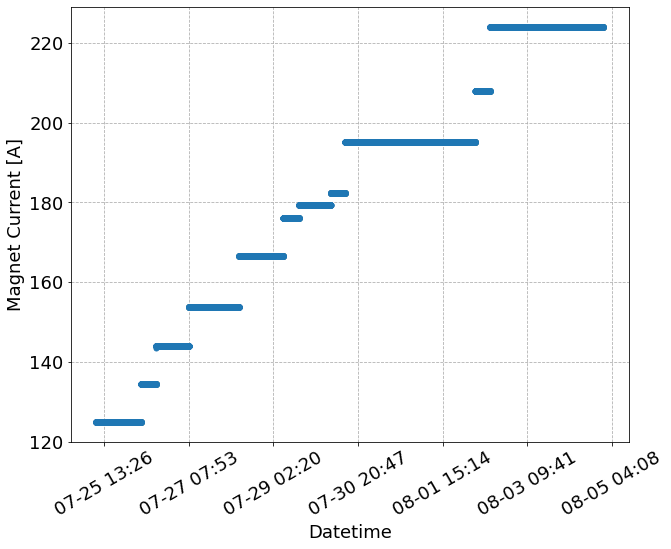

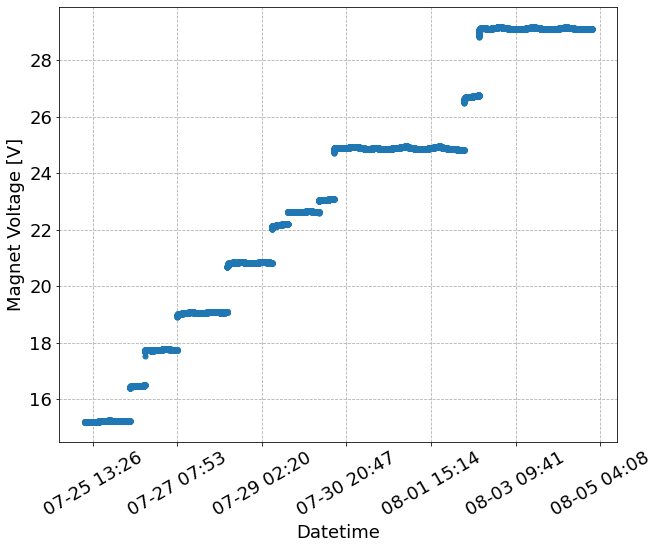

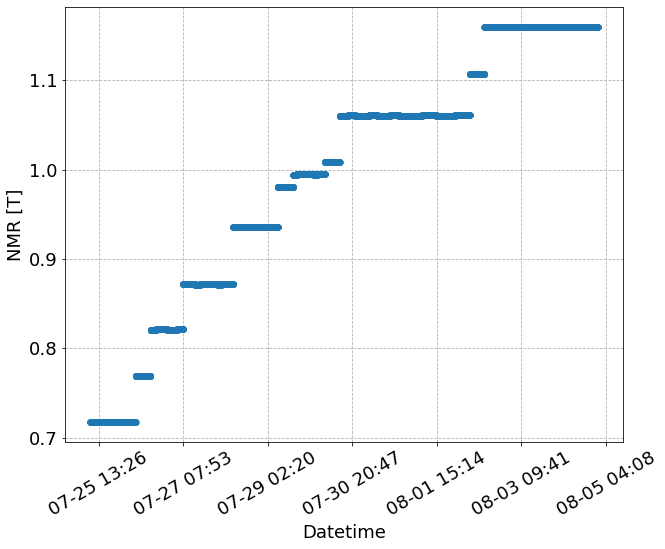

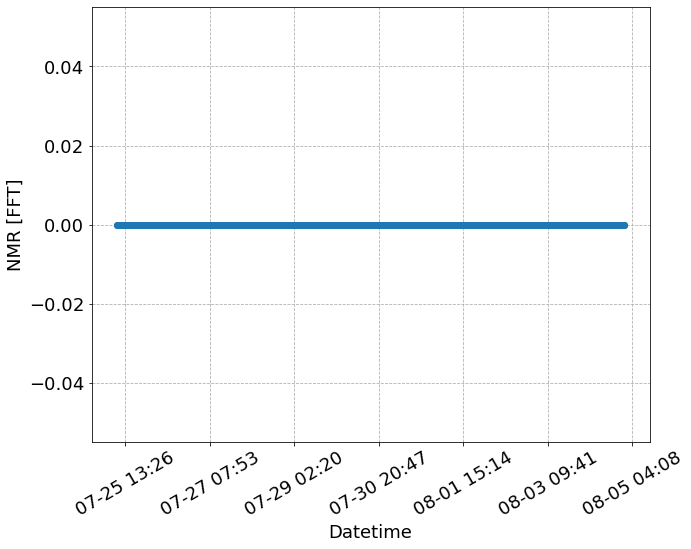

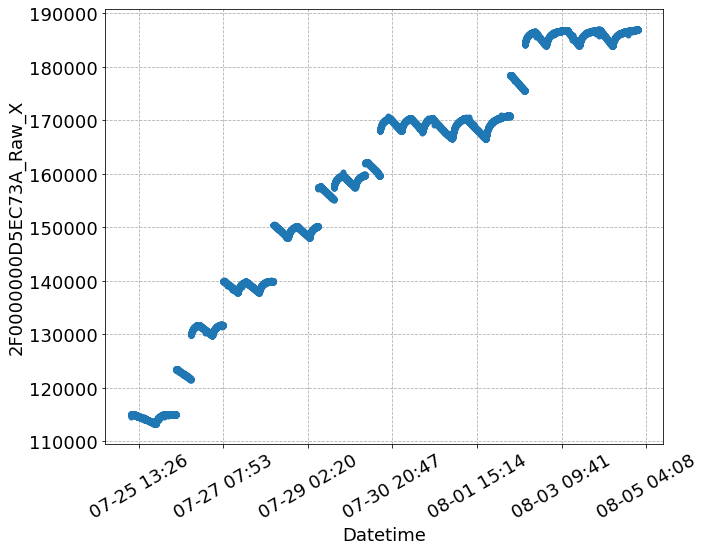

...

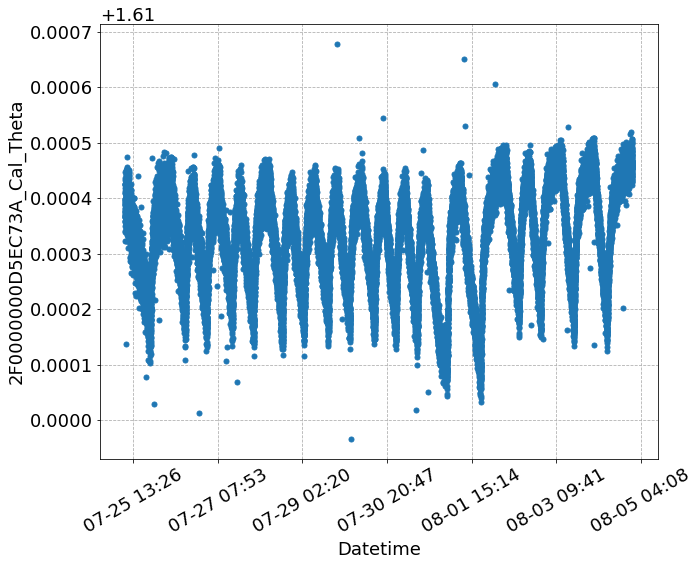

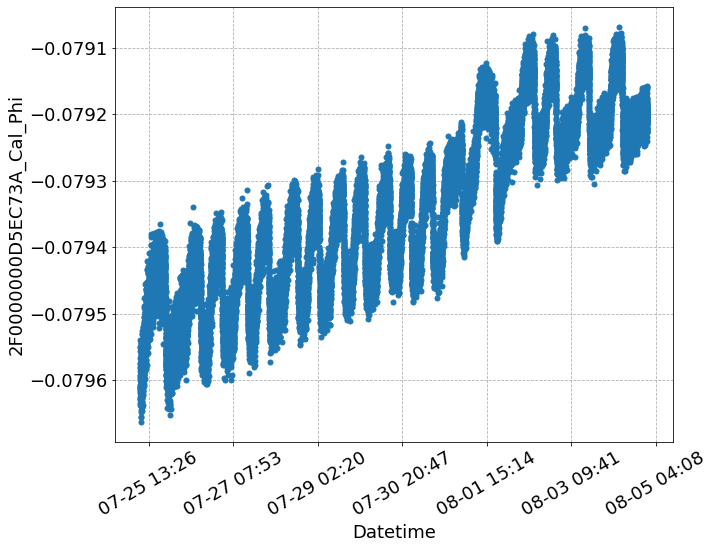

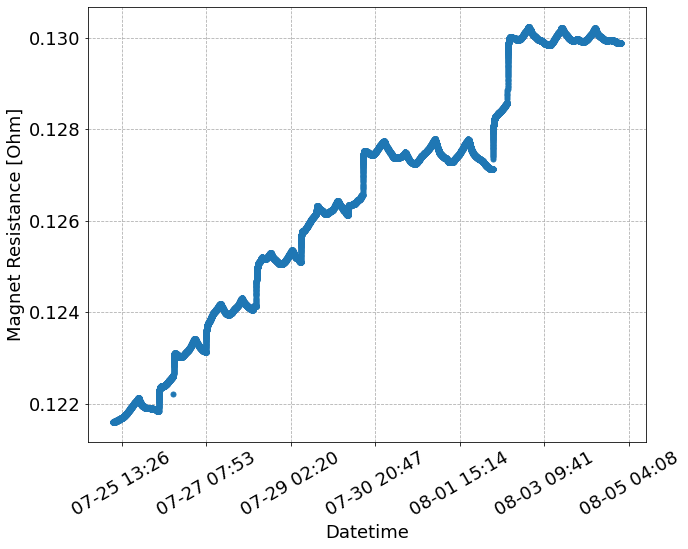

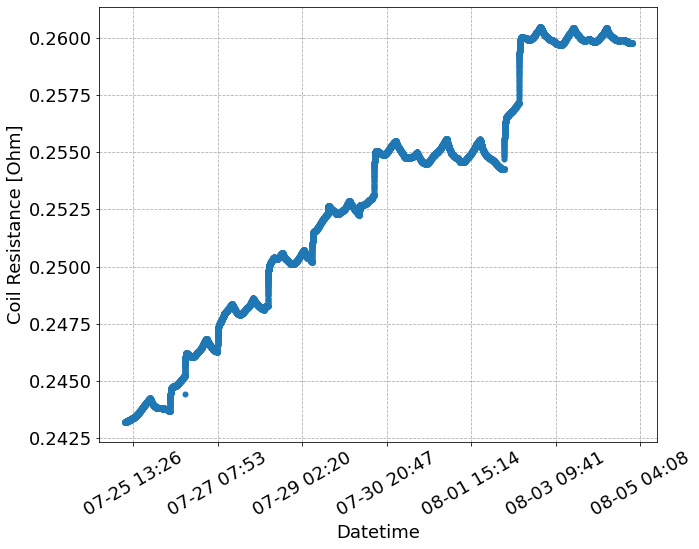

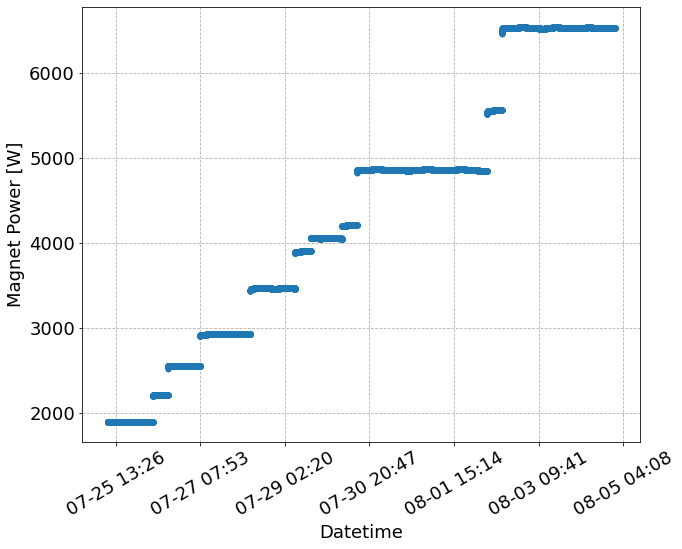

In [30]:
# plot vs. time
for col in df_.columns:
    if is_numeric_dtype(df_[col]):
        fig, ax = plt.subplots()
        ax = datetime_plt(ax, df_.index, df_[col], nmaj=6, Locator='Minute')
        ax.set_xlabel('Datetime')
        ax.set_ylabel(col)

/tmp/ipykernel_925439/2477770201.py:4: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



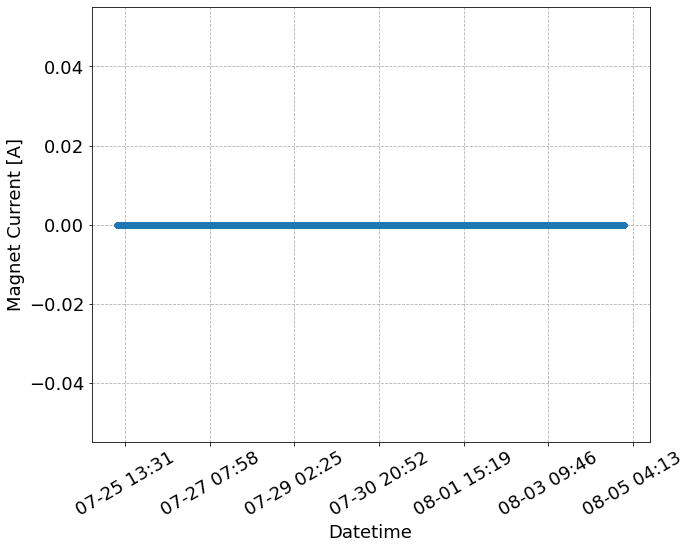

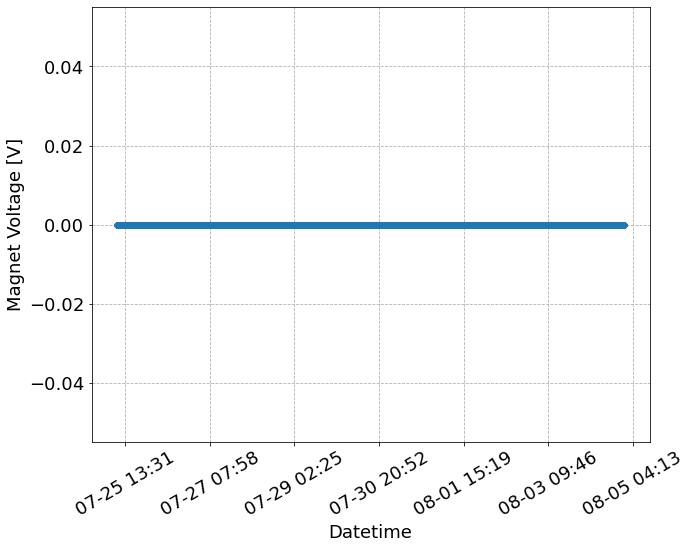

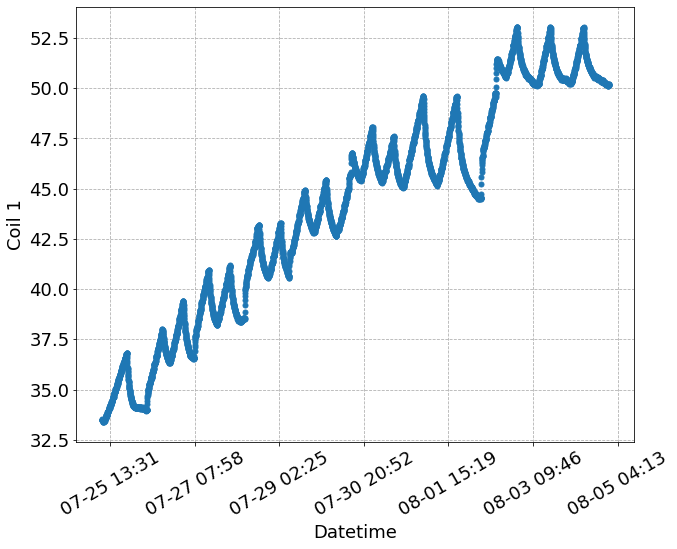

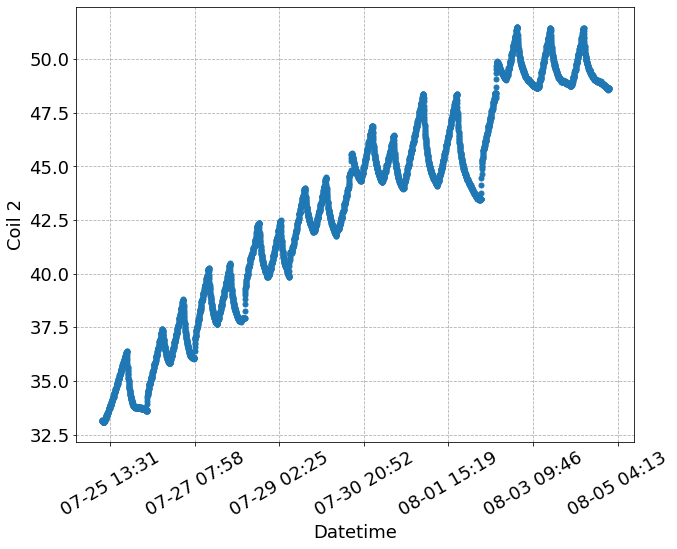

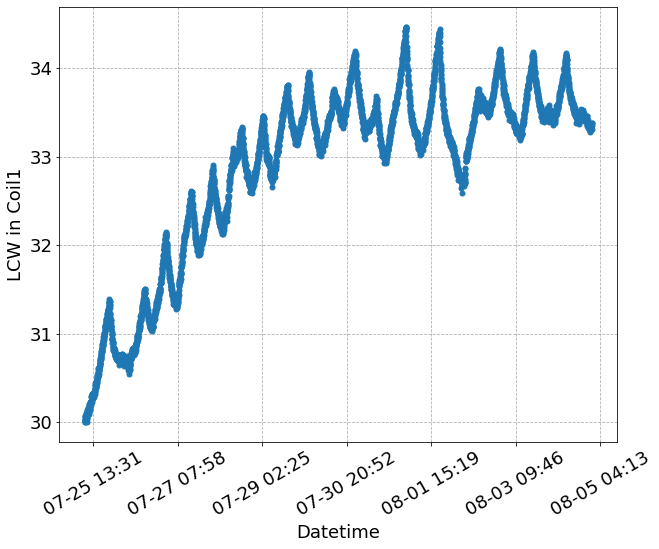

...

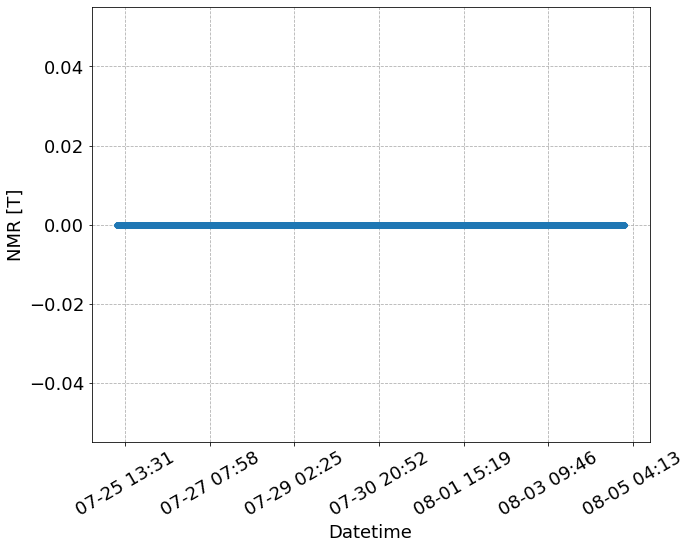

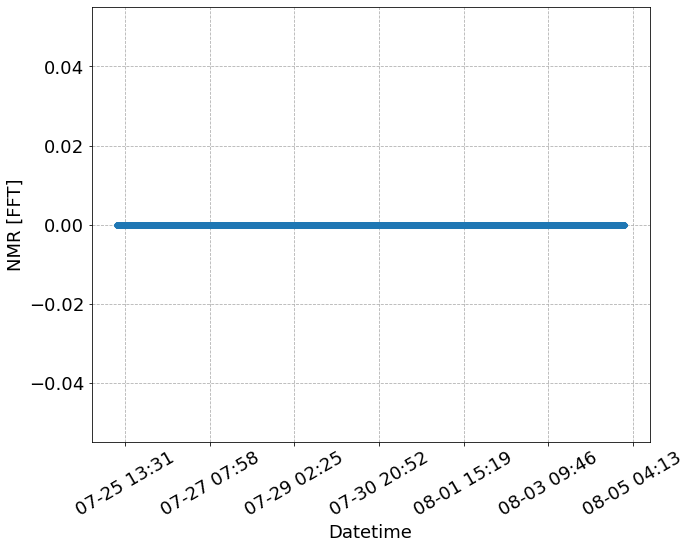

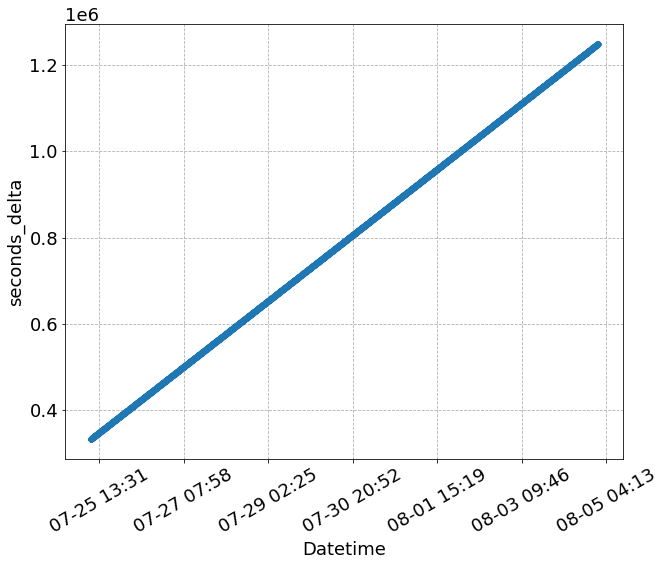

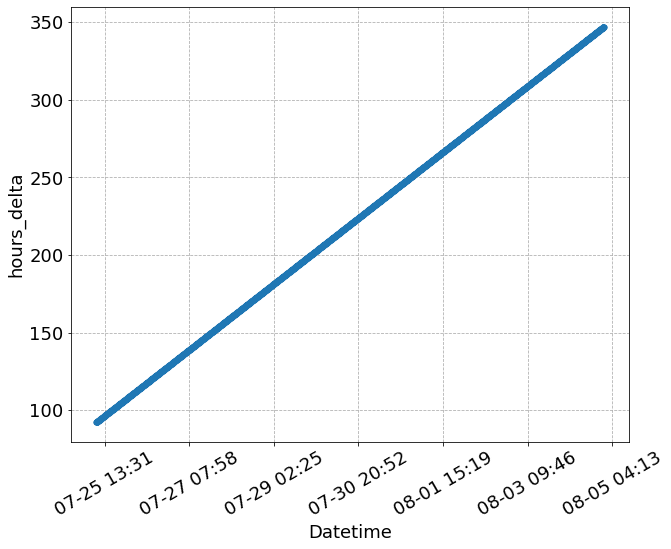

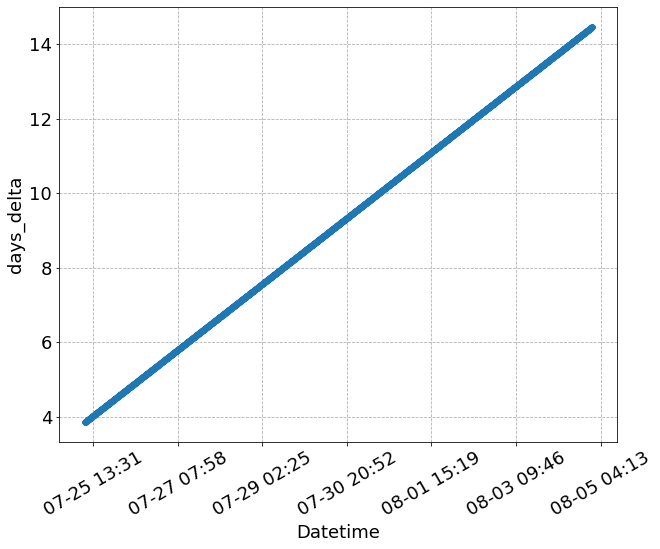

In [31]:
# plot vs. time
for col in df_temp_.columns:
    if is_numeric_dtype(df_temp_[col]):
        fig, ax = plt.subplots()
        ax = datetime_plt(ax, df_temp_.index, df_temp_[col], nmaj=6, Locator='Minute')
        ax.set_xlabel('Datetime')
        ax.set_ylabel(col)

In [32]:
df_['SmarAct_Meas_Angle_1'].describe()

count    45836.000000
mean       359.991096
std          0.001959
min        359.985404
25%        359.989746
50%        359.991190
75%        359.992626
max        359.994574
Name: SmarAct_Meas_Angle_1, dtype: float64

In [33]:
df_['SmarAct_Meas_Angle_2'].describe()

count    45836.000000
mean       292.943671
std          0.000883
min        292.941004
25%        292.943051
50%        292.943865
75%        292.944305
max        292.945167
Name: SmarAct_Meas_Angle_2, dtype: float64

In [34]:
probe

'2F0000000D5EC73A'

In [35]:
df_[f'{probe}_Cal_T'].describe()

count    45836.000000
mean        24.182461
std          4.455410
min         17.295000
25%         20.747000
50%         23.220500
75%         27.138000
max         39.979000
Name: 2F0000000D5EC73A_Cal_T, dtype: float64

- What happened with the jump in Zaber Z coordinate + jump in SmarAct angle 1 by 1 deg? (07-15-21)

In [36]:
#fig = scatter2d(df_.index, df_['Magnet Current [A]'], markers=True, lines=False, inline=True, show_plot=False)
#fig.update_layout(height=700, width=1000)

In [37]:
# looking at angles in HP and SmarAct

In [38]:
a1 = df_['SmarAct_Meas_Angle_1'].values * np.pi / 180.
a2 = df_['SmarAct_Meas_Angle_2'].values * np.pi / 180.

In [39]:
r_th = df_[f'{probe}_Raw_Theta'].values
r_ph = df_[f'{probe}_Raw_Phi'].values
c_th = df_[f'{probe}_Cal_Theta'].values
c_ph = df_[f'{probe}_Cal_Phi'].values

In [40]:
len(a1), len(r_th)

(45836, 45836)

In [41]:
# raw

In [42]:
df_[f'{probe}_Raw_Theta'].describe()

count    45836.000000
mean         3.047704
std          0.000206
min          3.047253
25%          3.047553
50%          3.047701
75%          3.047824
max          3.048335
Name: 2F0000000D5EC73A_Raw_Theta, dtype: float64

In [43]:
df_[f'{probe}_Raw_Theta'].max() - df_[f'{probe}_Raw_Theta'].min()

0.0010821731634922394

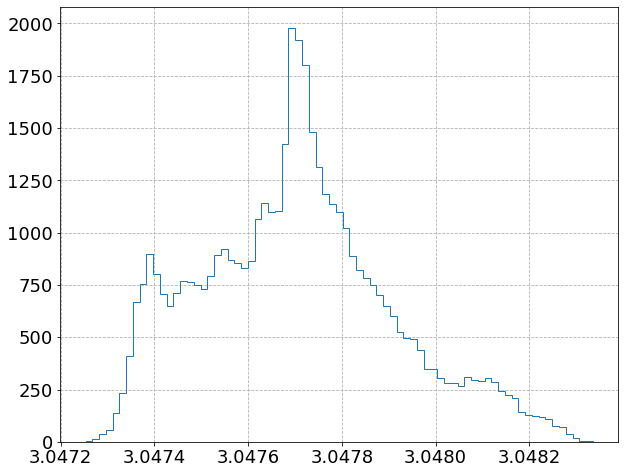

In [44]:
fig, ax = plt.subplots()
ax.hist(df_[f'{probe}_Raw_Theta'], bins=75, histtype='step');

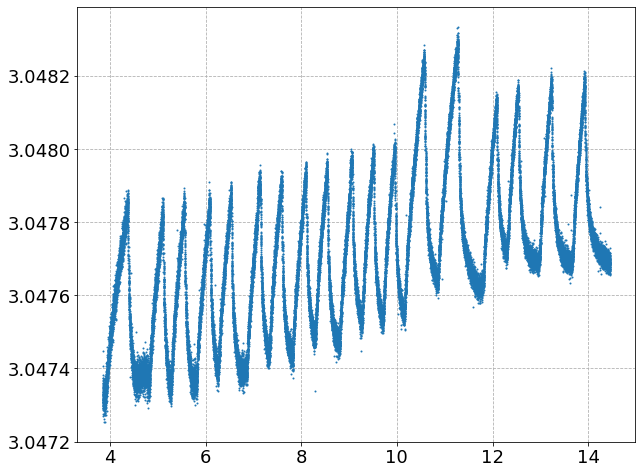

In [45]:
fig, ax = plt.subplots()
#ax.hist(df_[f'{probe}_Raw_Theta'], bins=75, histtype='step');
ax.scatter(df_['days_delta'], df_[f'{probe}_Raw_Theta'], s=1);

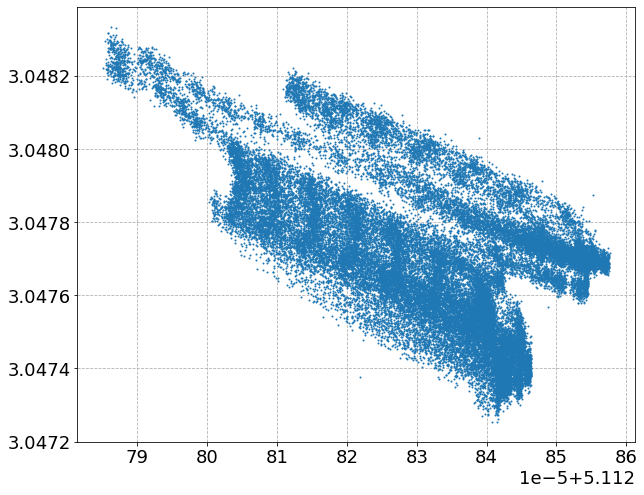

In [46]:
fig, ax = plt.subplots()
# ax.scatter(a1, r_th, s=1);
ax.scatter(a2, r_th, s=1);

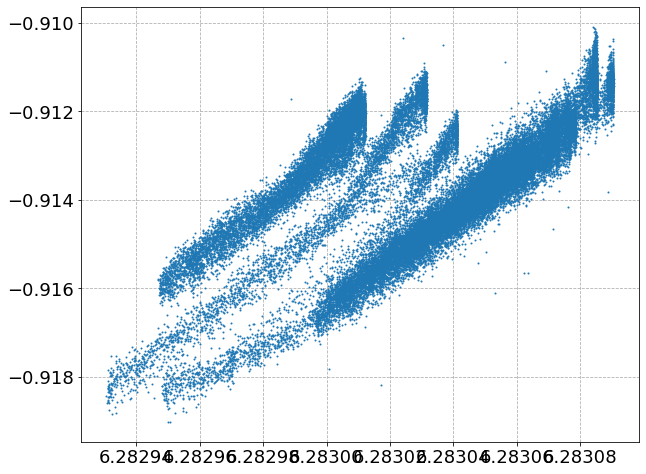

In [47]:
fig, ax = plt.subplots()
#ax.scatter(a2, r_ph, s=1);
ax.scatter(a1, r_ph, s=1);

In [48]:
# cal

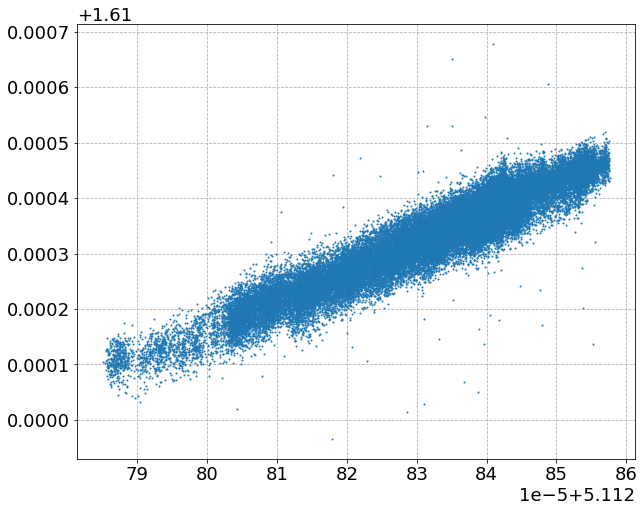

In [49]:
fig, ax = plt.subplots()
# ax.scatter(a1, c_th, s=1);
ax.scatter(a2, c_th, s=1);

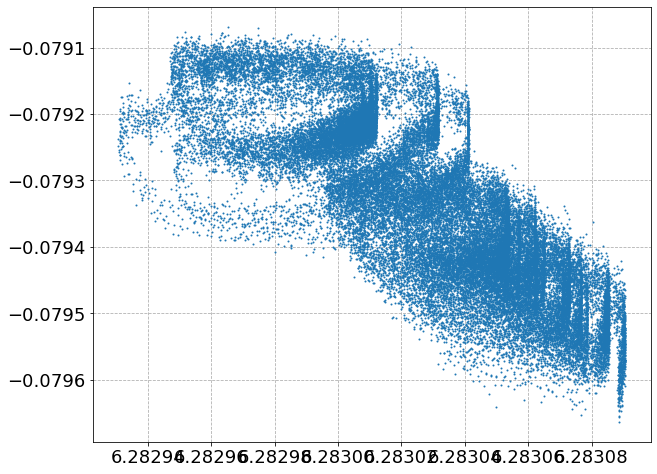

In [50]:
fig, ax = plt.subplots()
# ax.scatter(a2, c_ph, s=1);
ax.scatter(a1, c_ph, s=1);

## Select Times for Runs

In [51]:
#fig = scatter2d([df_.index, df_temp_.index], [df_[f'{probe}_Cal_T'], df_temp_['Parameter HVAC sensor']], markers=True, lines=False, inline=True, show_plot=False)
#fig.update_layout(height=700, width=1000)

In [52]:
ramp_Temps = [np.arange(12, 31, 1),
              np.arange(14, 32, 2),
              np.arange(14, 32, 2),
              np.arange(14, 32, 2),
              np.delete(np.arange(14, 32, 2), np.where(np.arange(14, 32, 2) == 28)), # FIXME! (clean this up)
              np.arange(14, 32, 2),
              np.arange(14, 32, 2),
              np.delete(np.arange(14, 32, 2), np.where(np.arange(14, 32, 2) == 28)), # FIXME! (clean this up)
              np.arange(14, 32, 2),
              ###np.arange(14, 42, 2), # repeat but to higher temperature
              np.arange(14, 32, 2), # Monday morning
              np.arange(14, 32, 2),
#               np.arange(14, 20, 2), # partial, updated through the day
             ]

In [53]:
# t0s = np.array(['2021-07-25 10:00',
t0s = np.array(['2021-07-25 09:21',
                '2021-07-26 08:10',
                '2021-07-26 19:05',
                '2021-07-27 07:50',
                '2021-07-28 09:00',
                '2021-07-29 08:00',
                '2021-07-29 18:50',
                '2021-07-30 07:37',
                '2021-07-30 18:00',
                ###'2021-07-31 15:15', # repeat but to higher temperature, #1
#                 '2021-08-01 06:40', # repeat but to higher temperature, #2
                '2021-08-02 07:45',
                '2021-08-02 18:40',
])

tfs = np.array(['2021-07-25 21:51:42',
                '2021-07-26 15:27',
                '2021-07-27 02:13',
                '2021-07-27 15:00',
                '2021-07-28 16:17',
                '2021-07-29 15:13', # CHECK THIS
                '2021-07-30 01:55',
                '2021-07-30 14:18', # CHECK THIS
                '2021-07-31 01:13',
#                 '2021-08-01 02:43', # repeat but to higher temperature, #1
                ###'2021-08-01 19:34', # repeat but to higher temperature, #2
                '2021-08-02 15:00',
                '2021-08-03 01:52',
])

## Filtering out Ramp Portions

### PGC Logfile

- example from current time
    - 44405.503866 , 2021-07-28 12:05:35 (+- a few seconds)

In [54]:
# 2 day offset from what the time should be
# hour, min, second appears correct
pgc_origin_time = datetime(year=1900, month=1, day=1) - timedelta(days=2)
pgc_origin_time

datetime.datetime(1899, 12, 30, 0, 0)

In [55]:
# TEST by looking at time in PGC software and conversion here
# 2021-7-28 12:29:24
pgc_origin_time + timedelta(days=44405.520417)

datetime.datetime(2021, 7, 28, 12, 29, 24, 28800)

In [56]:
#pgc_file = ddir+'1811121_7-22-21_1553.txt'
pgc_files = [ddir+'1811121_7-22-21_1553.txt',
             ddir+'1811121_07-29-21_0800.txt',
            ]

In [57]:
df_pgc = []
for pgc_file in pgc_files:
    df_pgc_ = pd.read_csv(pgc_file, delim_whitespace=True, skiprows=28, names=['Time', 'AP', 'RP', 'WP', 'AO', 'WS', 'WO', 'AS', 'RS'])
    #df_pgc = pd.read_csv(pgc_file, delimiter=' ', skiprows=28, names=['Time', 'AP', 'RP', 'WP', 'AO', 'WS', 'WO', 'AS', 'RS'])
    df_pgc_ = df_pgc_[['Time', 'AP', 'RP', 'WP', 'AO', 'WO', 'AS']]
    for col in df_pgc_.columns:
        df_pgc_[col] = pd.to_numeric(df_pgc_[col], errors='coerce')
    pgc_col_dict = {'Time': 'Time Float', 'AP': 'Air Temperature', 'RP': 'Relative Humidity', 'WP': 'Water Temperature', 'AO': 'Air Output', 'WO': 'Water Output', 'AS': 'Air Set Point'}
    df_pgc_.rename(columns=pgc_col_dict, inplace=True)
    df_pgc_['Datetime'] = [pgc_origin_time + timedelta(days=days) for days in df_pgc_['Time Float']]
    df_pgc_.sort_values(by=['Datetime'], inplace=True)
    df_pgc_ = df_pgc_.set_index('Datetime')
    df_pgc.append(df_pgc_)
df_pgc = pd.concat(df_pgc, ignore_index=False)
df_pgc['hours_delta'] = (df_pgc['Time Float'] - df_pgc['Time Float'].min()) * 24.
df_pgc['seconds_delta'] = df_pgc['hours_delta'] * 60. * 60.
df_pgc['days_delta'] = df_pgc['hours_delta'] / 24.

In [58]:
# Relative humidity limits of NMR
max_RH = 80 # @31 deg C (or lower)
min_RH = 50 # @40 deg C
T0 = 31
Tf = 40
# m = 

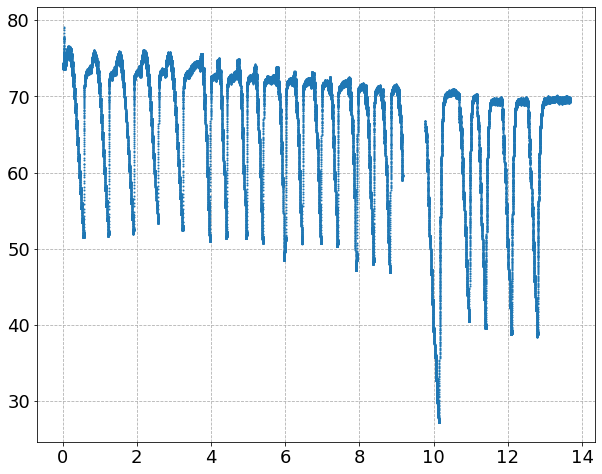

In [59]:
fig, ax = plt.subplots()
ax.scatter(df_pgc['days_delta'], df_pgc['Relative Humidity'], s=1)

In [60]:
# ORIGINAL
# df_pgc = pd.read_csv(pgc_file, delim_whitespace=True, skiprows=28, names=['Time', 'AP', 'RP', 'WP', 'AO', 'WS', 'WO', 'AS', 'RS'])
# #df_pgc = pd.read_csv(pgc_file, delimiter=' ', skiprows=28, names=['Time', 'AP', 'RP', 'WP', 'AO', 'WS', 'WO', 'AS', 'RS'])
# df_pgc = df_pgc[['Time', 'AP', 'RP', 'WP', 'AO', 'WO', 'AS']]
# for col in df_pgc.columns:
#     df_pgc[col] = pd.to_numeric(df_pgc[col], errors='coerce')
# pgc_col_dict = {'Time': 'Time Float', 'AP': 'Air Temperature', 'RP': 'Relative Humidity', 'WP': 'Water Temperature', 'AO': 'Air Output', 'WO': 'Water Output', 'AS': 'Air Set Point'}
# df_pgc.rename(columns=pgc_col_dict, inplace=True)
# df_pgc['Datetime'] = [pgc_origin_time + timedelta(days=days) for days in df_pgc['Time Float']]
# df_pgc.sort_values(by=['Datetime'], inplace=True)
# df_pgc = df_pgc.set_index('Datetime')
# df_pgc['hours_delta'] = (df_pgc['Time Float'] - df_pgc['Time Float'].min()) * 24.
# df_pgc['seconds_delta'] = df_pgc['hours_delta'] * 60. * 60.
# df_pgc['days_delta'] = df_pgc['hours_delta'] / 24.

In [61]:
df_pgc

,Time Float,Air Temperature,Relative Humidity,Water Temperature,Air Output,Water Output,Air Set Point,hours_delta,seconds_delta,days_delta
Datetime,,,,,,,,,,
2021-07-22 15:54:33.004800,44399.662882,12.99,74.04,8.22,0.0,0.0,12.0,0.000000,0.000000e+00,0.000000
2021-07-22 15:54:43.027200,44399.662998,12.99,74.05,8.22,0.0,0.0,12.0,0.002784,1.002240e+01,0.000116
2021-07-22 15:54:52.963200,44399.663113,13.01,74.07,8.23,0.0,0.0,12.0,0.005544,1.995840e+01,0.000231
2021-07-22 15:55:02.985600,44399.663229,12.96,74.08,8.23,0.0,0.0,12.0,0.008328,2.998080e+01,0.000347
2021-07-22 15:55:13.008000,44399.663345,12.98,74.05,8.22,0.0,0.0,12.0,0.011112,4.000320e+01,0.000463
...,...,...,...,...,...,...,...,...,...,...
2021-08-05 07:59:26.966400,44413.332951,14.57,69.90,9.64,0.0,0.0,14.0,328.081656,1.181094e+06,13.670069
2021-08-05 07:59:36.988800,44413.333067,14.62,69.84,9.64,0.0,0.0,14.0,328.084440,1.181104e+06,13.670185
2021-08-05 07:59:47.011200,44413.333183,14.62,69.84,9.64,0.0,0.0,14.0,328.087224,1.181114e+06,13.670301


In [62]:
# i = 0 # good
# i = 1 # good
# i = 2 # good
#i = 3 # good
#i = 4 # good
#i = 5 # good
# i = 6 # good
# i = 7 # good
# i = 8 # good
###i = 9 # good, but messy (two datasets, PGC off for 14 hours)
i = 9 # good
# i = 10 # good
df_pgc_r = df_pgc.query(f'("{t0s[i]}" <= Datetime <= "{tfs[i]}")')
#df_temp_r = df_temp_.query(f'("{t0s[i]}" <= Datetime <= "{tfs[i]}")')
df_r = df_.query(f'("{t0s[i]}" <= Datetime <= "{tfs[i]}")')
df_temp_r = df_temp_.query(f'("{t0s[i]}" <= Datetime <= "{tfs[i]}")')

In [63]:
df_pgc_r

,Time Float,Air Temperature,Relative Humidity,Water Temperature,Air Output,Water Output,Air Set Point,hours_delta,seconds_delta,days_delta
Datetime,,,,,,,,,,
2021-08-02 07:45:07.027200,44410.322998,14.07,69.95,9.03,3.6,3.6,14.0,255.842784,921034.022401,10.660116
2021-08-02 07:45:16.963200,44410.323113,14.05,69.95,9.04,4.2,4.2,14.0,255.845544,921043.958400,10.660231
2021-08-02 07:45:26.985600,44410.323229,14.01,70.01,9.04,5.6,5.6,14.0,255.848328,921053.980800,10.660347
2021-08-02 07:45:37.008000,44410.323345,14.00,70.15,9.04,5.9,5.9,14.0,255.851112,921064.003200,10.660463
2021-08-02 07:45:47.980800,44410.323472,14.01,70.18,9.04,5.6,5.6,14.0,255.854160,921074.976000,10.660590
...,...,...,...,...,...,...,...,...,...,...
2021-08-02 14:59:16.972800,44410.624502,30.08,40.91,29.39,34.6,33.9,30.0,263.078880,947083.968000,10.961620
2021-08-02 14:59:26.995200,44410.624618,30.06,40.89,29.39,35.2,35.2,30.0,263.081664,947093.990400,10.961736
2021-08-02 14:59:37.017600,44410.624734,30.09,40.89,29.39,34.1,34.1,30.0,263.084448,947104.012800,10.961852


In [64]:
# df_pgc_r.info()

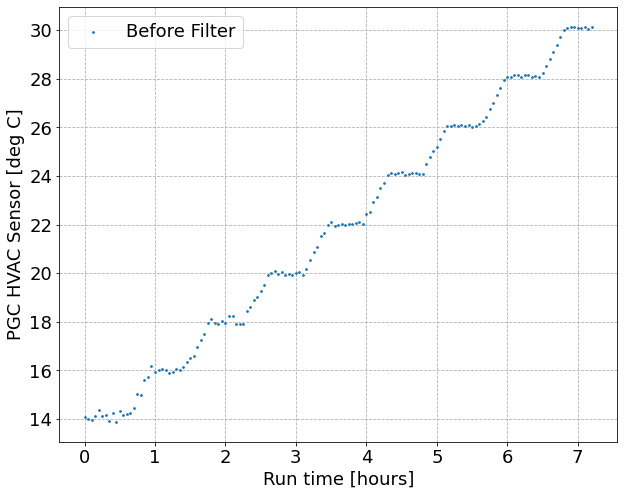

In [65]:
fig, ax = plt.subplots()

h0 = df_temp_r.hours_delta.min()

ax.scatter(df_temp_r.hours_delta - h0, df_temp_r['Parameter HVAC sensor'], s=3, label='Before Filter')
# ax.scatter(df_temp_d.hours_delta - h0, df_temp_d['Parameter HVAC sensor'], s=3, label='After Filter')

ax.set_xlabel('Run time [hours]')
ax.set_ylabel('PGC HVAC Sensor [deg C]')

ax.legend();

In [66]:
Temp_r = ramp_Temps[i]

In [67]:
Temp_r

array([14, 16, 18, 20, 22, 24, 26, 28, 30])

In [68]:
buffer_minutes = 1.
queries = []
for T in Temp_r:
    df_p = df_pgc_r.query(f'`Air Set Point` == {T}').copy()
    t0_p = df_p.index.min() + timedelta(minutes=buffer_minutes)
    # kludge for PGC off
    tf_p = t0_p + timedelta(minutes=30-buffer_minutes)
    #tf_p = df_p.index.max() - timedelta(minutes=buffer_minutes)
    queries.append(f'("{t0_p}" <= Datetime <= "{tf_p}")')
query_str = " or ".join(queries)

df_d = df_r.query(query_str, engine='python').copy()
df_temp_d = df_temp_r.query(query_str, engine='python').copy()
df_pgc_d = df_pgc_r.query(query_str, engine='python').copy()

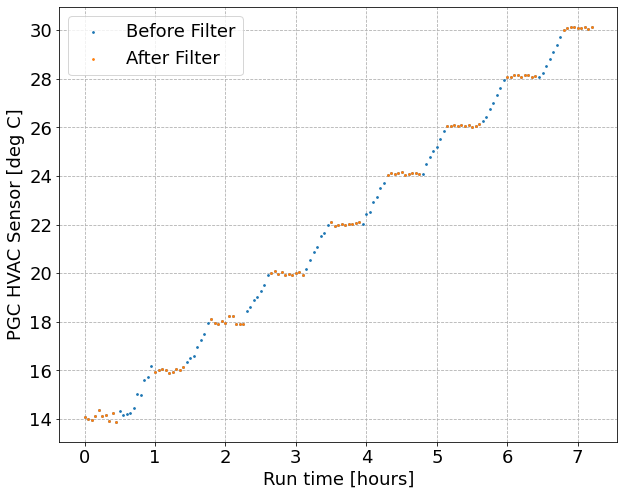

In [69]:
fig, ax = plt.subplots()

h0 = df_temp_r.hours_delta.min()

ax.scatter(df_temp_r.hours_delta - h0, df_temp_r['Parameter HVAC sensor'], s=3, label='Before Filter')
ax.scatter(df_temp_d.hours_delta - h0, df_temp_d['Parameter HVAC sensor'], s=3, label='After Filter')

ax.set_xlabel('Run time [hours]')
ax.set_ylabel('PGC HVAC Sensor [deg C]')

ax.legend();

- Combine filter for all measurements

In [70]:
dfs = []
dfs_temp = []
dfs_pgc = []

for i in range(len(t0s)):
    df_pgc_r = df_pgc.query(f'("{t0s[i]}" <= Datetime <= "{tfs[i]}")')
    #df_temp_r = df_temp_.query(f'("{t0s[i]}" <= Datetime <= "{tfs[i]}")')
    df_r = df_.query(f'("{t0s[i]}" <= Datetime <= "{tfs[i]}")')
    df_temp_r = df_temp_.query(f'("{t0s[i]}" <= Datetime <= "{tfs[i]}")')
    # add run number
    df_pgc_r['step'] = i
    df_r['step'] = i
    df_temp_r['step'] = i

    Temp_r = ramp_Temps[i]

    buffer_minutes = 1.
    queries = []
    for T in Temp_r:
        df_p = df_pgc_r.query(f'`Air Set Point` == {T}').copy()
        t0_p = df_p.index.min() + timedelta(minutes=buffer_minutes)
        # kludge for PGC off
        tf_p = t0_p + timedelta(minutes=30-buffer_minutes)
#         tf_p = df_p.index.max() - timedelta(minutes=buffer_minutes)
        queries.append(f'("{t0_p}" <= Datetime <= "{tf_p}")')
    query_str = " or ".join(queries)

    df_d = df_r.query(query_str, engine='python').copy()
    df_temp_d = df_temp_r.query(query_str, engine='python').copy()
    df_pgc_d = df_pgc_r.query(query_str, engine='python').copy()
    ## append dataframe lists
    dfs.append(df_d)
    dfs_temp.append(df_temp_d)
    dfs_pgc.append(df_pgc_d)

df_clean = pd.concat(dfs, ignore_index=False)
df_temp_clean = pd.concat(dfs_temp, ignore_index=False)
df_pgc_clean = pd.concat(dfs_pgc, ignore_index=False)

In [71]:
df_clean

,Time,Magnet Current [A],Magnet Voltage [V],NMR [T],NMR [FFT],2F0000000D5EC73A_Raw_X,2F0000000D5EC73A_Raw_Y,2F0000000D5EC73A_Raw_Z,2F0000000D5EC73A_Raw_T,2F0000000D5EC73A_Cal_X,...,2F0000000D5EC73A_Raw_Bmag,2F0000000D5EC73A_Raw_Theta,2F0000000D5EC73A_Raw_Phi,2F0000000D5EC73A_Cal_Bmag,2F0000000D5EC73A_Cal_Theta,2F0000000D5EC73A_Cal_Phi,Magnet Resistance [Ohm],Coil Resistance [Ohm],Magnet Power [W],step
Datetime,,,,,,,,,,,,,,,,,,,,,
2021-07-25 09:22:07,7/25/2021 9:22:07 AM,124.836157,15.179502,0.717460,0.0,114944.0,-148287.0,-1985446.0,18044.0,0.714904,...,1.994291e+06,3.047375,-0.911395,0.717734,1.610374,-0.079550,0.121595,0.243191,1894.950648,0
2021-07-25 09:22:34,7/25/2021 9:22:34 AM,124.836327,15.179518,0.717459,0.0,114950.0,-148465.0,-1985578.0,18037.0,0.714950,...,1.994436e+06,3.047309,-0.911951,0.717785,1.610370,-0.079634,0.121595,0.243191,1894.955309,0
2021-07-25 09:22:53,7/25/2021 9:22:53 AM,124.836327,15.179538,0.717460,0.0,115074.0,-148377.0,-1985514.0,18013.0,0.714921,...,1.994373e+06,3.047303,-0.911142,0.717755,1.610436,-0.079593,0.121596,0.243191,1894.957806,0
2021-07-25 09:23:12,7/25/2021 9:23:12 AM,124.836157,15.179578,0.717460,0.0,115054.0,-148411.0,-1985527.0,18009.0,0.714924,...,1.994387e+06,3.047296,-0.911337,0.717759,1.610425,-0.079609,0.121596,0.243192,1894.960219,0
2021-07-25 09:23:31,7/25/2021 9:23:31 AM,124.836383,15.179602,0.717461,0.0,114979.0,-148340.0,-1985482.0,18004.0,0.714907,...,1.994333e+06,3.047345,-0.911421,0.717739,1.610389,-0.079575,0.121596,0.243192,1894.966573,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-08-03 01:50:33,8/3/2021 1:50:33 AM,224.062380,29.181267,1.158962,0.0,184058.0,-239500.0,-3223452.0,32122.0,1.154667,...,3.237573e+06,3.048160,-0.915554,1.159192,1.610219,-0.079125,0.130237,0.260474,6538.424061,10
2021-08-03 01:50:52,8/3/2021 1:50:52 AM,224.062380,29.181350,1.158962,0.0,183952.0,-239598.0,-3223481.0,32136.0,1.154684,...,3.237603e+06,3.048157,-0.916030,1.159210,1.610184,-0.079155,0.130238,0.260475,6538.442733,10
2021-08-03 01:51:11,8/3/2021 1:51:11 AM,224.062380,29.181417,1.158961,0.0,183922.0,-239487.0,-3223476.0,32129.0,1.154678,...,3.237588e+06,3.048189,-0.915885,1.159200,1.610175,-0.079120,0.130238,0.260476,6538.457670,10


In [72]:
df_clean.step

Datetime
2021-07-25 09:22:07     0
2021-07-25 09:22:34     0
2021-07-25 09:22:53     0
2021-07-25 09:23:12     0
2021-07-25 09:23:31     0
                       ..
2021-08-03 01:50:33    10
2021-08-03 01:50:52    10
2021-08-03 01:51:11    10
2021-08-03 01:51:30    10
2021-08-03 01:51:50    10
Name: step, Length: 9275, dtype: int64

In [73]:
len(df_), len(df_clean)

(45836, 9275)

In [74]:
# fig = scatter2d([df_.index, df_temp_.index], [df_[f'{probe}_Cal_T'], df_temp_['Parameter HVAC sensor']], markers=True, lines=False, inline=True, show_plot=False)
# fig.update_layout(height=700, width=1000)

In [75]:
fig = scatter2d([df_clean.index, df_temp_clean.index], [df_clean[f'{probe}_Cal_T'], df_temp_clean['Parameter HVAC sensor']], markers=True, lines=False, inline=True, show_plot=False)
fig.update_layout(height=700, width=1000)

In [76]:
fig = scatter2d([df_clean.index, df_temp_clean.index, df_pgc_clean.index],
                [df_clean[f'{probe}_Cal_T'], df_temp_clean['Parameter HVAC sensor'], df_pgc_clean['Air Set Point']],
                markers=True, size_list=3*[5], lines=False, inline=True, show_plot=False)
fig.update_layout(height=700, width=1000)

In [77]:
fig = scatter2d([df_clean.index, df_temp_clean.index, df_pgc_clean.index, df_temp_clean.index],
                [df_clean[f'{probe}_Cal_T'], df_temp_clean['Parameter HVAC sensor'], df_pgc_clean['Air Set Point'], df_temp_clean['Yoke (center magnet)'],],
                markers=True, size_list=4*[3], lines=False, inline=True, show_plot=False)
fig.update_layout(height=700, width=1000)

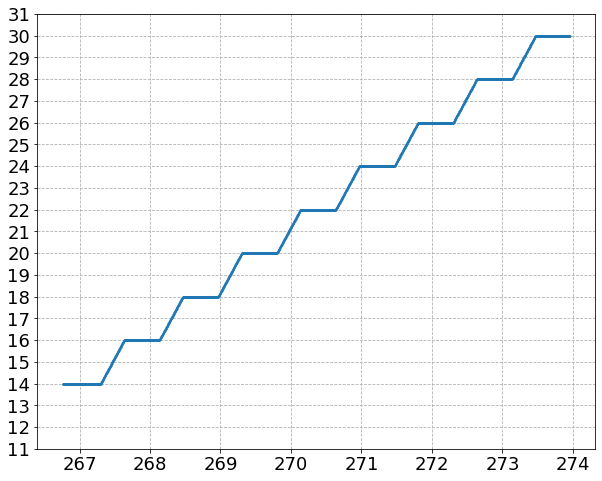

In [78]:
fig, ax = plt.subplots()

ax.scatter(df_pgc_r.hours_delta.values, df_pgc_r['Air Set Point'].values, s=1)

ax.set_yticks(np.arange(11, 32, 1.0));

# ax.plot(df_pgc_r.hours_delta.values, df_pgc_r['Air Set Point'].values)
# plt.locator_params(axis='y', nbins=6)
# ax.x

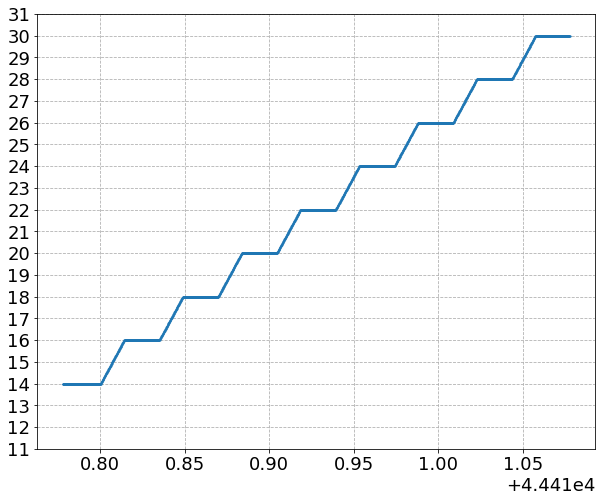

In [79]:
fig, ax = plt.subplots()

ax.scatter(df_pgc_r['Time Float'].values, df_pgc_r['Air Set Point'].values, s=1)

ax.set_yticks(np.arange(11, 32, 1.0));

# ax.plot(df_pgc_r.hours_delta.values, df_pgc_r['Air Set Point'].values)
# plt.locator_params(axis='y', nbins=6)
# ax.x

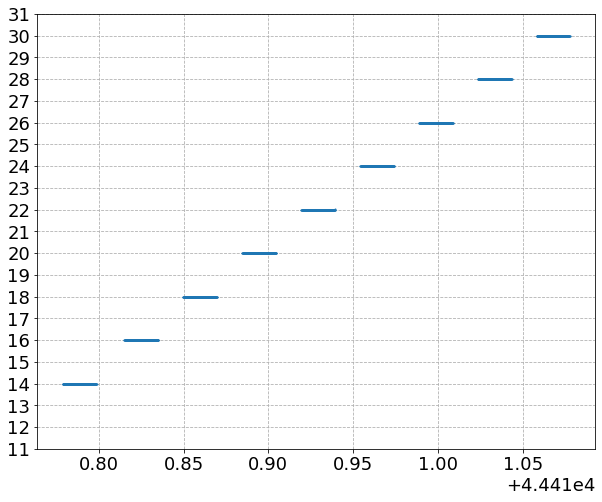

In [80]:
fig, ax = plt.subplots()

ax.scatter(df_pgc_d['Time Float'].values, df_pgc_d['Air Set Point'].values, s=1)

ax.set_yticks(np.arange(11, 32, 1.0));

In [81]:
# NO FILTERING
#query_string = ' or '.join([f'("{t0_}" <= Datetime <= "{tf_}")' for t0_, tf_ in zip(t0s, tfs)])
#df_run = df_.query(query_string).copy()
# FILTERED
df_run = df_clean.copy()

In [82]:
# NO FILTERING, for validation
# query_string = ' or '.join([f'("{t0_}" <= Datetime <= "{tf_}")' for t0_, tf_ in zip(t0s, tfs)])
# df_run_full = df_.query(query_string).copy()

In [83]:
t0

'2021-07-25 09:15'

In [84]:
# Multiple ramps before fit data, some fast, some slow, for validation
query_string = f'(Datetime <= "{t0}") and (`NMR [T]` > 0.68)' 
df_run_full = df.query(query_string).copy()

In [85]:
len(df_run_full)

16611

In [86]:
df_run

,Time,Magnet Current [A],Magnet Voltage [V],NMR [T],NMR [FFT],2F0000000D5EC73A_Raw_X,2F0000000D5EC73A_Raw_Y,2F0000000D5EC73A_Raw_Z,2F0000000D5EC73A_Raw_T,2F0000000D5EC73A_Cal_X,...,2F0000000D5EC73A_Raw_Bmag,2F0000000D5EC73A_Raw_Theta,2F0000000D5EC73A_Raw_Phi,2F0000000D5EC73A_Cal_Bmag,2F0000000D5EC73A_Cal_Theta,2F0000000D5EC73A_Cal_Phi,Magnet Resistance [Ohm],Coil Resistance [Ohm],Magnet Power [W],step
Datetime,,,,,,,,,,,,,,,,,,,,,
2021-07-25 09:22:07,7/25/2021 9:22:07 AM,124.836157,15.179502,0.717460,0.0,114944.0,-148287.0,-1985446.0,18044.0,0.714904,...,1.994291e+06,3.047375,-0.911395,0.717734,1.610374,-0.079550,0.121595,0.243191,1894.950648,0
2021-07-25 09:22:34,7/25/2021 9:22:34 AM,124.836327,15.179518,0.717459,0.0,114950.0,-148465.0,-1985578.0,18037.0,0.714950,...,1.994436e+06,3.047309,-0.911951,0.717785,1.610370,-0.079634,0.121595,0.243191,1894.955309,0
2021-07-25 09:22:53,7/25/2021 9:22:53 AM,124.836327,15.179538,0.717460,0.0,115074.0,-148377.0,-1985514.0,18013.0,0.714921,...,1.994373e+06,3.047303,-0.911142,0.717755,1.610436,-0.079593,0.121596,0.243191,1894.957806,0
2021-07-25 09:23:12,7/25/2021 9:23:12 AM,124.836157,15.179578,0.717460,0.0,115054.0,-148411.0,-1985527.0,18009.0,0.714924,...,1.994387e+06,3.047296,-0.911337,0.717759,1.610425,-0.079609,0.121596,0.243192,1894.960219,0
2021-07-25 09:23:31,7/25/2021 9:23:31 AM,124.836383,15.179602,0.717461,0.0,114979.0,-148340.0,-1985482.0,18004.0,0.714907,...,1.994333e+06,3.047345,-0.911421,0.717739,1.610389,-0.079575,0.121596,0.243192,1894.966573,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-08-03 01:50:33,8/3/2021 1:50:33 AM,224.062380,29.181267,1.158962,0.0,184058.0,-239500.0,-3223452.0,32122.0,1.154667,...,3.237573e+06,3.048160,-0.915554,1.159192,1.610219,-0.079125,0.130237,0.260474,6538.424061,10
2021-08-03 01:50:52,8/3/2021 1:50:52 AM,224.062380,29.181350,1.158962,0.0,183952.0,-239598.0,-3223481.0,32136.0,1.154684,...,3.237603e+06,3.048157,-0.916030,1.159210,1.610184,-0.079155,0.130238,0.260475,6538.442733,10
2021-08-03 01:51:11,8/3/2021 1:51:11 AM,224.062380,29.181417,1.158961,0.0,183922.0,-239487.0,-3223476.0,32129.0,1.154678,...,3.237588e+06,3.048189,-0.915885,1.159200,1.610175,-0.079120,0.130238,0.260476,6538.457670,10


In [87]:
len(df), len(df_), len(df_run)

(63960, 45836, 9275)

In [88]:
plotdir

'/home/ckampa/data/hallprobecalib_extras/plots/hall_probe_B_T/07-21-21_12:58/'

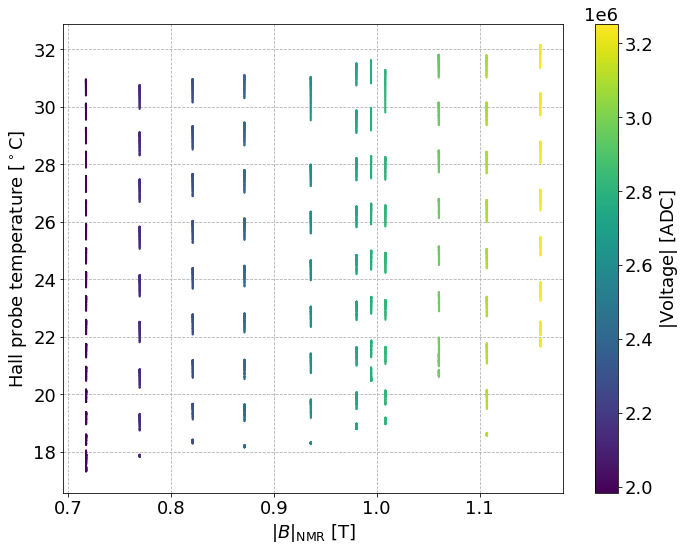

In [89]:
fig, ax = plt.subplots()
fig.patch.set_facecolor('white')

sc = ax.scatter(df_run['NMR [T]'], df_run[f'{probe}_Cal_T'], c=df_run[f'{probe}_Raw_Bmag'], s=1)
cb = fig.colorbar(sc, label=r'$|\mathrm{Voltage}|$ [ADC]')

ax.set_xlabel(r'$|B|_\mathrm{NMR}$ [T]')
ax.set_ylabel(r'Hall probe temperature [$^\circ$C]');
fig.tight_layout()
fig.savefig(plotdir+'V_vs_T_B.png')
fig.savefig(plotdir+'V_vs_T_B.pdf')

In [90]:
fig = scatter3d(df_run['NMR [T]'], df_run[f'{probe}_Cal_T'], df_run[f'{probe}_Raw_Bmag'], inline=True, show_plot=False)
fig.update_layout(height=700, width=1000)

## Initial Combined Fit

### Simple Polynomial

In [91]:
df_run[[f'{probe}_Cal_T', 'NMR [T]']].describe()

,2F0000000D5EC73A_Cal_T,NMR [T]
count,9275.000000,9275.000000
mean,24.415876,0.925498
std,4.050539,0.144783
min,17.315000,0.717324
25%,21.053000,0.769574
50%,24.235000,0.935938
75%,27.880000,1.060204
max,32.142000,1.159252


In [92]:
T0 = 24.0
B0 = 0.96

# T0 = 23.99
# B0 = 0.805

def model_quad_B_T(B, T, **params):
    return params['C_0'] + params['B_1'] * (B-B0) + params['B_2'] * (B-B0)**2 + params['B_3'] * (B-B0)**3 \
         + params['T_1'] * (T-T0) + params['T_2'] * (T-T0)**2 + params['T_3'] * (T-T0)**3

In [93]:
#coord = 'Z'

In [94]:
#std_V = 600 # 2e-4, microvolts
###std_V = 90 # 3e-5, microvolts
# magnitude
std_V = 3e-5 * df_run[f'{probe}_Raw_Bmag'] # 3e-5, microvolts
# one component
#std_V = 3e-5 * df_run[f'{probe}_Raw_{coord}'] # 3e-5, microvolts

#std_V = 160 # 5.2e-5, microvolts

# std_B = 1e-4
std_B = 3e-5 * df_run[f'{probe}_Cal_Bmag']
std_T = 0.0006 * df_run[f'{probe}_Cal_T'] # same as used in magnet ramp, but check for Hall probe temp probes! FIXME!

In [95]:
std_V

Datetime
2021-07-25 09:22:07    59.828733
2021-07-25 09:22:34    59.833083
2021-07-25 09:22:53    59.831190
2021-07-25 09:23:12    59.831619
2021-07-25 09:23:31    59.829987
                         ...    
2021-08-03 01:50:33    97.127197
2021-08-03 01:50:52    97.128100
2021-08-03 01:51:11    97.127653
2021-08-03 01:51:30    97.126946
2021-08-03 01:51:50    97.123821
Name: 2F0000000D5EC73A_Raw_Bmag, Length: 9275, dtype: float64

In [96]:
model = lm.Model(model_quad_B_T, independent_vars=['B', 'T'])
params = lm.Parameters()
params.add('C_0', value=0, vary=True)
params.add('B_1', value=0, vary=True)
params.add('B_2', value=0, vary=True)
# params.add('B_2', value=0, vary=False)
params.add('B_3', value=0, vary=False)
params.add('T_1', value=0, vary=True)
params.add('T_2', value=0, vary=False)
params.add('T_3', value=0, vary=False)
# magnitude
results = model.fit(df_run[f'{probe}_Raw_Bmag'].values, B=df_run['NMR [T]'].values,
                    T=df_run[f'{probe}_Cal_T'].values, params=params,
                    weights= 1./std_V)
                    #weights= np.ones_like(df_run[f'{probe}_Cal_Bmag'])/std_V)
# one component
# results = model.fit(df_run[f'{probe}_Raw_{coord}'].values, B=df_run['NMR [T]'].values,
#                     T=df_run[f'{probe}_Cal_T'].values, params=params,
#                     weights= 1./std_V)
#                     #weights= np.ones_like(df_run[f'{probe}_Cal_Bmag'])/std_V)

In [97]:
results

In [98]:
results.plot()

Fit can only be plotted if the model function has one independent variable.


False

In [99]:
res = results.best_fit - results.data
res_pd = pd.Series(res, name='Residuals [micro V]')
res_rel = (results.best_fit - results.data) / results.data
res_rel_pd = pd.Series(res_rel, name='Relative Residuals')

In [100]:
# fig.patch.set_facecolor('white')
# fig.tight_layout()
# fig.savefig(plotdir+'V_vs_T_B.png')
# fig.savefig(plotdir+'V_vs_T_B.pdf')

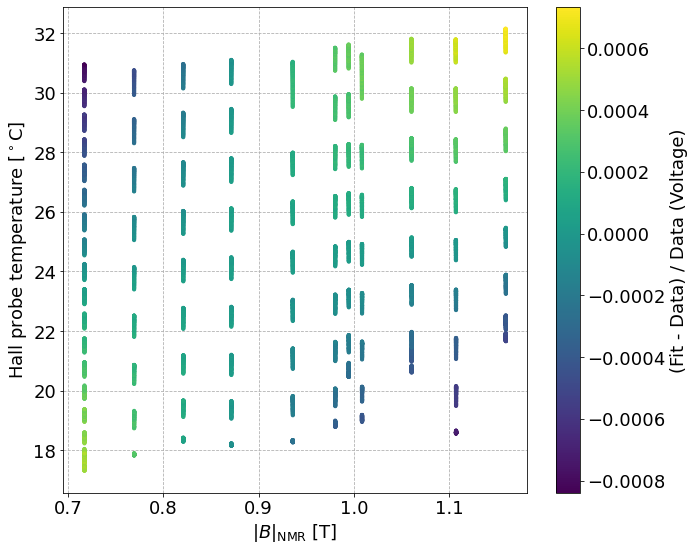

In [101]:
fig, ax = plt.subplots()
fig.patch.set_facecolor('white')
sc = ax.scatter(df_run['NMR [T]'], df_run[f'{probe}_Cal_T'], s=10, c=res_rel)
cb = fig.colorbar(sc, label=r'(Fit - Data) / Data (Voltage)')

ax.set_xlabel(r'$|B|_\mathrm{NMR}$ [T]')
ax.set_ylabel(r'Hall probe temperature [$^\circ$C]');
fig.tight_layout()
fig.savefig(plotdir+'simple_fit_res_vs_T_B.png')
fig.savefig(plotdir+'simple_fit_res_vs_T_B.pdf')

In [102]:
fig = histo(res_pd, bins=100, show_plot=False)
fig.update_layout(height=700, width=1000)

In [103]:
fig = histo(res_rel_pd, bins=100, show_plot=False)
fig.add_traces([go.Scatter(x=[-1e-4, -1e-4], y=[0, 160], mode='lines', line=dict(color='red', dash='dash'), name='1e-4')])
fig.add_traces([go.Scatter(x=[1e-4, 1e-4], y=[0, 160], mode='lines', line=dict(color='red', dash='dash'), name='')])
fig.update_layout(height=700, width=1000)

### Chebyshev

In [104]:
# altered from simulation / fitting studies September 2020
# but removed theta & phi dependence
def V_forward(Bs, ts, **params):
    '''
    Parameters: 
    length-N numpy.arrays -- Bs (magnetic field), 
    ts (temperature)
    dictionary -- params where key is of form "c_knlm"
    and value is a float. Also needs "Bmin, Bmax, tmin, tmax" for scaling Chebyshev polynomial inputs
    
    Return: V (Hall voltage), a length-N numpy.array
    '''
#     params_ = deepcopy(dict(params)) # wrap with dict for use in lmfit
    params_ = params
    # normalizations
    B_sub = (params['Bmax'] + params['Bmin']) / 2
    B_div = (params['Bmax'] - params['Bmin']) / 2
    Bs_scaled = (Bs - B_sub) / B_div
    t_sub = (params['tmax'] + params['tmin']) / 2
    t_div = (params['tmax'] - params['tmin']) / 2
    ts_scaled = (ts - t_sub) / t_div
    # sum limits
    kmax = params['kmax']
    nmax = params['nmax']
    # delete non-sum related parameters
    #[params.pop(key) for key in ['Bmin', 'Bmax', 'tmin', 'tmax', 'kmax', 'nmax', 'lmax', 'theta0', 'phi0']]
    
#     [params.pop(key) for key in ['Bmin', 'Bmax', 'tmin', 'tmax', 'kmax', 'nmax']]
    
    # loop B
#     V = 0.
    V = np.zeros_like(Bs_scaled)
    for k in range(kmax+1):
        coeffs_k = np.zeros(kmax+1)
        coeffs_k[k] = 1.
        T_k = np.polynomial.chebyshev.chebval(Bs_scaled, coeffs_k)
        # loop t
        for n in range(nmax+1):
            c_kn = params[f'c_{k}{n}']
            coeffs_n = np.zeros(nmax+1)
            coeffs_n[n] = 1.
            T_n = np.polynomial.chebyshev.chebval(ts_scaled, coeffs_n)
            V += c_kn * T_k * T_n 
    
    return V

In [105]:
# looking at a single component
# THETA0 = df_[f'{probe}_Raw_Theta'].mean() - np.pi # CHECK PHASE
THETA0 = 0. # cos(0) = 1. use for magnitude
#
# Bcomp = 'Z'
Bcomp = 'Bmag' # magnitude

In [106]:
#std_V = 600 # 2e-4, microvolts
###std_V = 90 # 3e-5, microvolts
# magnitude
std_V = 3e-5 * df_run[f'{probe}_Raw_{Bcomp}'] # 3e-5, microvolts, component
# std_V = 3e-5 * df_run[f'{probe}_Raw_Bmag'] # 3e-5, microvolts, magnitude
# one component
#std_V = 3e-5 * df_run[f'{probe}_Raw_{coord}'] # 3e-5, microvolts

#std_V = 160 # 5.2e-5, microvolts

# std_B = 1e-4
std_B = 3e-5 * df_run[f'{probe}_Cal_{Bcomp}']
# std_B = 3e-5 * df_run[f'{probe}_Cal_Bmag']
std_T = 0.0006 * df_run[f'{probe}_Cal_T'] # same as used in magnet ramp, but check for Hall probe temp probes! FIXME!

In [107]:
df_run.eval(f'B_scaled = cos({THETA0}) * `NMR [T]`', inplace=True)
df_run_full.eval(f'B_scaled = cos({THETA0}) * `NMR [T]`', inplace=True)

In [108]:
THETA0

0.0

In [109]:
df_run[[f'{probe}_Cal_T', 'NMR [T]', 'B_scaled']].describe()

,2F0000000D5EC73A_Cal_T,NMR [T],B_scaled
count,9275.000000,9275.000000,9275.000000
mean,24.415876,0.925498,0.925498
std,4.050539,0.144783,0.144783
min,17.315000,0.717324,0.717324
25%,21.053000,0.769574,0.769574
50%,24.235000,0.935938,0.935938
75%,27.880000,1.060204,1.060204
max,32.142000,1.159252,1.159252


In [110]:
Bmin = 0.71 # T
# Bmax = 1.11 # T
Bmax = 1.16 # T
tmin = 17.3 # deg C
tmax = 32.2 # deg C
# tmax = 40. # deg C, high temp test

In [111]:
# full range test
# Bmin = 0. # T
# Bmax = 2.25 # T
# tmin = 17.3 # deg C
# #tmax = 31.8 # deg C
# tmax = 40. # deg C, high temp test

In [112]:
Bmin, Bmax, tmin, tmax

(0.71, 1.16, 17.3, 32.2)

In [113]:
# from Bergsma
# kmax = 5
# nmax = 2
# test higher dim
#kmax = 6
#nmax = 4
# 2023-10-27 12:51:25 trying fewer terms for a minimal model
kmax = 2
nmax = 2

In [114]:
# testing poor fits
# kmax = 1
# nmax = 0

In [115]:
kmax, nmax

(2, 2)

In [116]:
# construct model
model = lm.Model(V_forward, independent_vars=['Bs', 'ts'])
params = lm.Parameters()
for k in range(kmax+1):
    for n in range(nmax+1):
        params.add(f'c_{k}{n}', value=0)
params.add('Bmin', value=Bmin, vary=False)
params.add('Bmax', value=Bmax, vary=False)
params.add('tmin', value=tmin, vary=False)
params.add('tmax', value=tmax, vary=False)
params.add('kmax', value=kmax, vary=False)
params.add('nmax', value=nmax, vary=False)

In [117]:
V_forward(Bs=df_run['B_scaled'].values,
          ts=df_run[f'{probe}_Cal_T'].values,
          **params)

array([0., 0., 0., ..., 0., 0., 0.])

In [118]:
len(std_V), len(df_run)

(9275, 9275)

In [119]:
%%time
# fit!
# old
# result = model.fit(df_run[f'{probe}_Raw_Bmag'].values, Bs=df_run['NMR [T]'].values, ts=df_run[f'{probe}_Cal_T'].values,
#                    params=params, weights= 1/std_V.values, method='leastsq')#_squares')
# include component
result = model.fit(df_run[f'{probe}_Raw_{Bcomp}'].values, Bs=df_run['B_scaled'].values, ts=df_run[f'{probe}_Cal_T'].values,
                   params=params, weights= 1/std_V.values, method='leastsq')#_squares')

CPU times: user 126 ms, sys: 1.03 ms, total: 127 ms
Wall time: 83.7 ms


In [120]:
# partial most recent run
# Bz
result

In [121]:
result.plot()

Fit can only be plotted if the model function has one independent variable.


False

In [122]:
slowfile

'/home/ckampa/Dropbox/LogFiles/2021-07-21 125802slow.txt'

In [123]:
slowtempfile

'/home/ckampa/Dropbox/LogFiles/2021-07-21 125810slow.txt'

In [126]:
#type(result_pkl.params)

In [127]:
#dict(result_pkl.params)

In [128]:
params['c_00'].vary 

True

In [129]:
# save the params only
pkl.dump(result.params, open(pkldir+'2021-07-21_V_vs_B_T_fit_params.pkl','wb'))

In [130]:
#### SAVE RESULTS / PARAMS (V forward)
pkl.dump(result, open(pkldir+'2021-07-21_V_vs_B_T_fit_result.pkl','wb'))
#pkl.dump(result, open(pkldir+'2021-07-21_V_vs_B_T_fit_result_high_dim.pkl','wb'))

In [131]:
result_pkl = pkl.load(open(pkldir+'2021-07-21_V_vs_B_T_fit_result.pkl','rb'))
#result_pkl = pkl.load(open(pkldir+'2021-07-21_V_vs_B_T_fit_result_high_dim.pkl','rb'))

In [132]:
result_pkl

In [133]:
result_pkl.userkws['Bs']

array([0.71745955, 0.71745938, 0.71745977, ..., 1.15896123, 1.15896066,
       1.15896022])

In [134]:
result_pkl.userkws['ts']

array([18.044, 18.037, 18.013, ..., 32.129, 32.14 , 32.142])

In [135]:
result_pkl.data

array([1994291.09620963, 1994436.09895354, 1994372.98512615, ...,
       3237588.43088942, 3237564.86369524, 3237460.71057874])

In [136]:
result_pkl.best_fit

array([1994293.07021528, 1994298.38684719, 1994319.43108918, ...,
       3237468.84267177, 3237452.9273479 , 3237449.08880049])

In [137]:
df_ = pd.DataFrame({'B': result_pkl.userkws['Bs'], 'Temp': result_pkl.userkws['ts'], 'V': result_pkl.data, 'V_fit': result_pkl.best_fit})

In [138]:
df_

,B,Temp,V,V_fit
0,0.717460,18.044,1.994291e+06,1.994293e+06
1,0.717459,18.037,1.994436e+06,1.994298e+06
2,0.717460,18.013,1.994373e+06,1.994319e+06
3,0.717460,18.009,1.994387e+06,1.994323e+06
4,0.717461,18.004,1.994333e+06,1.994329e+06
...,...,...,...,...
9270,1.158962,32.122,3.237573e+06,3.237481e+06
9271,1.158962,32.136,3.237603e+06,3.237461e+06
9272,1.158961,32.129,3.237588e+06,3.237469e+06
9273,1.158961,32.140,3.237565e+06,3.237453e+06


In [139]:
print(df_)

             B    Temp             V         V_fit
0     0.717460  18.044  1.994291e+06  1.994293e+06
1     0.717459  18.037  1.994436e+06  1.994298e+06
2     0.717460  18.013  1.994373e+06  1.994319e+06
3     0.717460  18.009  1.994387e+06  1.994323e+06
4     0.717461  18.004  1.994333e+06  1.994329e+06
...        ...     ...           ...           ...
9270  1.158962  32.122  3.237573e+06  3.237481e+06
9271  1.158962  32.136  3.237603e+06  3.237461e+06
9272  1.158961  32.129  3.237588e+06  3.237469e+06
9273  1.158961  32.140  3.237565e+06  3.237453e+06
9274  1.158960  32.142  3.237461e+06  3.237449e+06

[9275 rows x 4 columns]


In [140]:
print(result_pkl.fit_report(show_correl=False))

[[Model]]
    Model(V_forward)
[[Fit Statistics]]
    # fitting method   = leastsq
    # function evals   = 171
    # data points      = 9275
    # variables        = 9
    chi-square         = 7144.18809
    reduced chi-square = 0.77101102
    Akaike info crit   = -2402.99238
    Bayesian info crit = -2338.77668
[[Variables]]
    c_00:  2607074.34 +/- 1.07209203 (0.00%) (init = 0)
    c_01: -7931.69124 +/- 1.61696529 (0.02%) (init = 0)
    c_02:  130.609497 +/- 1.55538465 (1.19%) (init = 0)
    c_10:  641194.163 +/- 1.73145794 (0.00%) (init = 0)
    c_11: -2259.15997 +/- 2.63336113 (0.12%) (init = 0)
    c_12:  10.0088454 +/- 2.46925729 (24.67%) (init = 0)
    c_20:  2176.10106 +/- 1.35350822 (0.06%) (init = 0)
    c_21: -22.2700320 +/- 2.05264019 (9.22%) (init = 0)
    c_22: -5.93504209 +/- 1.93042854 (32.53%) (init = 0)
    Bmin:  0.71 (fixed)
    Bmax:  1.16 (fixed)
    tmin:  17.3 (fixed)
    tmax:  32.2 (fixed)
    kmax:  2 (fixed)
    nmax:  2 (fixed)


In [141]:
pkldir

'/home/ckampa/data/hallprobecalib_extras/datafiles/V_vs_B_T/'

In [142]:
Bmax, Bmin

(1.16, 0.71)

In [143]:
tmin, tmax

(17.3, 32.2)

In [144]:
V_forward(Bmin, tmin, **result.params)

array(1973865.74417004)

In [145]:
V_forward(Bmax, tmin, **result.params)

array(3260792.40855193)

In [146]:
V_forward(1., tmin, **result.params)

array(2799199.5586966)

In [147]:
V_forward(1., 12., **result.params)

array(2805827.43891781)

In [148]:
V_forward(1., tmax, **result.params)

array(2782067.98950071)

In [149]:
result_pkl

In [150]:
res = result.best_fit - result.data
# res_pd = pd.Series(res, name='Residuals [micro V]')
res_pd = pd.Series(res, name='Residuals [ADC]')
res_rel = (result.best_fit - result.data) / result.data
res_rel_pd = pd.Series(res_rel, name='Relative Residuals')

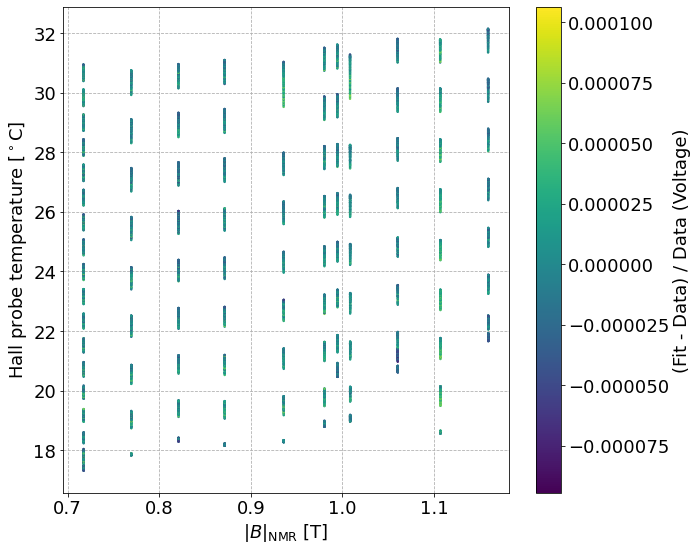

In [151]:
fig, ax = plt.subplots()
fig.patch.set_facecolor('white')
#sc = ax.scatter(df_run['NMR [T]'], df_run[f'{probe}_Cal_T'], s=10, c=res_rel)
sc = ax.scatter(df_run['NMR [T]'], df_run[f'{probe}_Cal_T'], s=2, c=res_rel)
cb = fig.colorbar(sc, label=r'(Fit - Data) / Data (Voltage)')

ax.set_xlabel(r'$|B|_\mathrm{NMR}$ [T]')
ax.set_ylabel(r'Hall probe temperature [$^\circ$C]');
fig.tight_layout()
fig.savefig(plotdir+'cheb_fit_vs_T_B.png')
fig.savefig(plotdir+'cheb_fit_vs_T_B.pdf')

In [152]:
# fig = scatter3d(df_run['NMR [T]'], df_run[f'{probe}_Cal_T'], res_rel_pd, inline=True, show_plot=False)
fig = scatter3d(df_run['B_scaled'], df_run[f'{probe}_Cal_T'], res_rel_pd, inline=True, show_plot=False)
fig.update_layout(height=700, width=1000)
fig.write_image(plotdir+'voltage_residual_vs_B_T_plotly.png')
fig.write_image(plotdir+'voltage_residual_vs_B_T_plotly.pdf')
fig

In [153]:
fig = histo(res_pd, bins=100, show_plot=False)
fig.update_layout(height=700, width=1000)

In [154]:
fig = histo(res_rel_pd, bins=75, show_plot=False)
fig.add_traces([go.Scatter(x=[-1e-4, -1e-4], y=[0, 450], mode='lines', line=dict(color='red', dash='dash'), name='1e-4')])
fig.add_traces([go.Scatter(x=[1e-4, 1e-4], y=[0, 450], mode='lines', line=dict(color='red', dash='dash'), name='')])
fig.update_layout(height=700, width=1000)
fig.update_xaxes(range=[-1.25e-4, +1.25e-4])
fig.write_image(plotdir+'voltage_residual_histo.png')
fig.write_image(plotdir+'voltage_residual_histo.pdf')
fig

In [155]:
fig = histo(res_rel_pd, bins=75, show_plot=False)
fig.add_traces([go.Scatter(x=[-1e-4, -1e-4], y=[0, 450], mode='lines', line=dict(color='red', dash='dash'), name='1e-4')])
fig.add_traces([go.Scatter(x=[1e-4, 1e-4], y=[0, 450], mode='lines', line=dict(color='red', dash='dash'), name='')])
fig.update_layout(height=700, width=1000)
fig.update_yaxes(type='log')
fig.update_xaxes(range=[-1.25e-4, +1.25e-4])
fig.write_image(plotdir+'voltage_residual_histo_log.png')
fig.write_image(plotdir+'voltage_residual_histo_log.pdf')
fig

In [156]:
df_run.tail()

,Time,Magnet Current [A],Magnet Voltage [V],NMR [T],NMR [FFT],2F0000000D5EC73A_Raw_X,2F0000000D5EC73A_Raw_Y,2F0000000D5EC73A_Raw_Z,2F0000000D5EC73A_Raw_T,2F0000000D5EC73A_Cal_X,...,2F0000000D5EC73A_Raw_Theta,2F0000000D5EC73A_Raw_Phi,2F0000000D5EC73A_Cal_Bmag,2F0000000D5EC73A_Cal_Theta,2F0000000D5EC73A_Cal_Phi,Magnet Resistance [Ohm],Coil Resistance [Ohm],Magnet Power [W],step,B_scaled
Datetime,,,,,,,,,,,,,,,,,,,,,
2021-08-03 01:50:33,8/3/2021 1:50:33 AM,224.06238,29.181267,1.158962,0.0,184058.0,-239500.0,-3223452.0,32122.0,1.154667,...,3.048160,-0.915554,1.159192,1.610219,-0.079125,0.130237,0.260474,6538.424061,10,1.158962
2021-08-03 01:50:52,8/3/2021 1:50:52 AM,224.06238,29.181350,1.158962,0.0,183952.0,-239598.0,-3223481.0,32136.0,1.154684,...,3.048157,-0.916030,1.159210,1.610184,-0.079155,0.130238,0.260475,6538.442733,10,1.158962
2021-08-03 01:51:11,8/3/2021 1:51:11 AM,224.06238,29.181417,1.158961,0.0,183922.0,-239487.0,-3223476.0,32129.0,1.154678,...,3.048189,-0.915885,1.159200,1.610175,-0.079120,0.130238,0.260476,6538.457670,10,1.158961
2021-08-03 01:51:30,8/3/2021 1:51:30 AM,224.06238,29.181433,1.158961,0.0,183951.0,-239523.0,-3223448.0,32140.0,1.154674,...,3.048174,-0.915881,1.159197,1.610185,-0.079133,0.130238,0.260476,6538.461404,10,1.158961
2021-08-03 01:51:50,8/3/2021 1:51:50 AM,224.06238,29.181600,1.158960,0.0,184002.0,-239516.0,-3223341.0,32142.0,1.154638,...,3.048163,-0.915733,1.159162,1.610203,-0.079133,0.130239,0.260477,6538.498748,10,1.158960


# Inverting the Problem
- |V|(|B|, Temp) --> |B|(|V|, Temp)

In [157]:
#from scipy.optimize import fsolve

In [158]:
def inv_B(B, V, T, params):
    if not isinstance(B, np.ndarray):
        B = np.array([B])
        V = np.array([V])
        T = np.array([T])
    return [(V_forward(B, T, **params) - V)[0]]

def inv_B_v2(B, V, T, params):
#     if not isinstance(B, np.ndarray):
#         B = np.array([B])
#         V = np.array([V])
#         T = np.array([T])
    return [(V_forward(B, T, **params) - V)[0]]

In [159]:
type(np.array([1.2]))

numpy.ndarray

In [160]:
import collections.abc

In [161]:
collections.abc.Sequence

collections.abc.Sequence

In [162]:
isinstance(np.array([1.2, 0.]), np.ndarray)

True

In [163]:
inv_B(1., 2.795882852e6, 20., result.params)

[47.99742274172604]

In [164]:
inv_B(np.array([1.]), np.array([2.795882852e6]), np.array([20.]), result.params)

[47.99742274172604]

In [165]:
inv_B(np.array([1.+1e-4]), np.array([2.795882852e6]), np.array([20.]), result.params)

[334.7382848043926]

In [166]:
%time root = fsolve(func=inv_B, x0=[0.5], args=(2.795882852e6, 20., result.params))

CPU times: user 3.18 ms, sys: 0 ns, total: 3.18 ms
Wall time: 2.84 ms


In [167]:
%time root = fsolve(func=inv_B_v2, x0=[0.5], args=(2.795882852e6, 20., result.params))

CPU times: user 2.49 ms, sys: 90 µs, total: 2.58 ms
Wall time: 2.27 ms


In [168]:
Bmax

1.16

In [169]:
V_forward(2.24, tmin, **result.params)

array(6492538.62813974)

In [170]:
(Bmin+Bmax)/2

0.9349999999999999

In [172]:
fsolve(func=inv_B_v2, x0=[1.125], args=(-2.2289e6, 20., result.params))

array([-0.85645633])

In [173]:
V_forward(0, 20., **result.params)

array(15105.09917687)

In [174]:
Bmin

0.71

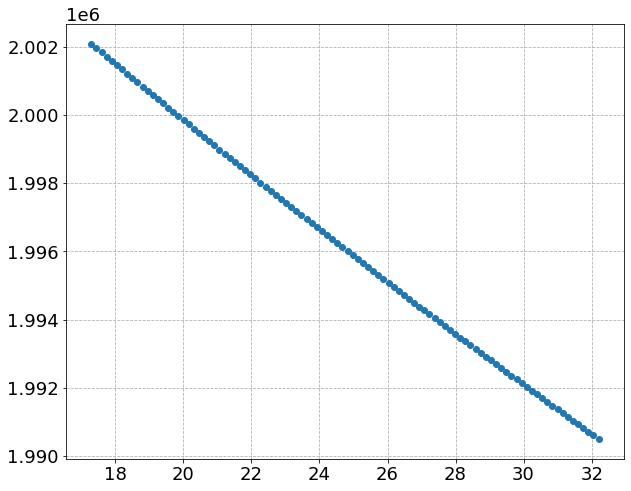

In [175]:
ts = np.linspace(tmin, tmax, 100)
# v0s = np.array([V_forward(0., t, **result.params) for t in ts])
v0s = np.array([V_forward(0.72, t, **result.params) for t in ts])

fig, ax = plt.subplots()
ax.scatter(ts, v0s)

In [176]:
(v0s[-1] - v0s[0]) / (ts[-1] - ts[0])

-777.3607081815212

In [177]:
# FROM MANUFACTURER: Temp. Coeff. of V_H, for B=0.05 T, I_C=5 mA, Ta=25-125 C, max = -0.06 % / deg C
1/v0s[-1] * (v0s[-1] - v0s[0]) / (ts[-1] - ts[0]) * 100

-0.03905353314996765

In [178]:
# looks good

In [179]:
(v0s[-1] - v0s[0]) / (ts[-1] - ts[0]) * 1e-6

-0.0007773607081815212

In [180]:
23e-3 * len(df_run)

213.325

In [181]:
root

array([0.99998326])

In [182]:
root1 = fsolve(func=inv_B, x0=[0.5], args=(2795881., 20., result.params))
root2 = fsolve(func=inv_B, x0=[0.5], args=(2795882., 20., result.params))
root3 = fsolve(func=inv_B, x0=[0.5], args=(2795883., 20., result.params))

In [183]:
root1, root2, root3

(array([0.99998262]), array([0.99998296]), array([0.99998331]))

In [184]:
root2-root1

array([3.48748362e-07])

In [185]:
root3-root2

array([3.48748355e-07])

--> Each ADC value corresponds to ~3.5e-7 Tesla

In [186]:
# SLOW
# B_cals = []
# #for row in df_run.itertuples():
# for i in range(len(df_run.iloc[:1000])):
#     row = df_run.iloc[i]
#     B_ = fsolve(func=inv_B, x0=[0.8], args=(row[f'{probe}_Raw_Bmag'], row[f'{probe}_Cal_T'], result.params))
#     B_cals.append(B_)
# B_cals = np.array(B_cals)
# # df_run['B_fit'] = B_cals

In [187]:
#df_run['B_fit']

In [188]:
# run in parallel

In [189]:
from tqdm.notebook import tqdm
from joblib import Parallel, delayed
import multiprocessing
from sys import stdout

In [190]:
def invert_row(df, index):
    row = df.iloc[index]
    #B_ = fsolve(func=inv_B, x0=[0.8], args=(row[f'{probe}_Raw_Bmag'], row[f'{probe}_Cal_T'], result.params))
    #B_ = fsolve(func=inv_B_v2, x0=[0.8], args=(np.array([row[f'{probe}_Raw_Bmag']]), np.array([row[f'{probe}_Cal_T']]), result.params))
    B_ = fsolve(func=inv_B_v2, x0=[0.8], args=(np.array([row[f'{probe}_Raw_{Bcomp}']]), np.array([row[f'{probe}_Cal_T']]), result.params))
    return B_[0]

In [191]:
i = 3000
invert_row(df_run, i), df_run['NMR [T]'].iloc[i]

(0.8210543484682923, 0.821046102)

In [192]:
# %%prun
# invert_row(df_run, 1234)

In [193]:
num_cpu = multiprocessing.cpu_count()
njs = min([num_cpu, len(df_run)])
# parallel for loop
temp = (Parallel(n_jobs=njs)(delayed(invert_row)(df_run, i) for i in tqdm(range(len(df_run)), file=stdout, desc='Measurement #')))
# temp = (Parallel(n_jobs=njs)(delayed(invert_row)(df_run, i) for i in tqdm(range(100), file=stdout, desc='Measurement #')))
# parse output
B_cals = np.ravel(temp)
df_run['B_fit'] = B_cals

Measurement #:   0%|          | 0/9275 [00:00<?, ?it/s]

In [194]:
num_cpu = multiprocessing.cpu_count()
njs = min([num_cpu, len(df_run_full)])
# parallel for loop
temp = (Parallel(n_jobs=njs)(delayed(invert_row)(df_run_full, i) for i in tqdm(range(len(df_run_full)), file=stdout, desc='Measurement #')))
# temp = (Parallel(n_jobs=njs)(delayed(invert_row)(df_run, i) for i in tqdm(range(100), file=stdout, desc='Measurement #')))
# parse output
B_cals = np.ravel(temp)
df_run_full['B_fit'] = B_cals

Measurement #:   0%|          | 0/16611 [00:00<?, ?it/s]

In [195]:
B_cals

array([0.7174817 , 0.71750825, 0.71746085, ..., 0.71749465, 0.71748468,
       0.71748884])

In [196]:
df_run['B_fit'].describe()

count    9275.000000
mean        0.925498
std         0.144783
min         0.717279
25%         0.769576
50%         0.935948
75%         1.060209
max         1.159306
Name: B_fit, dtype: float64

In [197]:
df_run.eval('(B_fit - `NMR [T]`)/`NMR [T]`').describe()

count    9.275000e+03
mean     1.343506e-09
std      2.576192e-05
min     -1.039089e-04
25%     -1.713121e-05
50%     -1.778234e-08
75%      1.743132e-05
max      9.268848e-05
dtype: float64

In [198]:
df_run_full.eval('(B_fit - `NMR [T]`)/`NMR [T]`').describe()

count    16611.000000
mean         0.000018
std          0.000043
min         -0.000166
25%         -0.000009
50%          0.000013
75%          0.000040
max          0.000192
dtype: float64

In [199]:
df_run.eval('(B_fit - B_scaled)/B_scaled').describe()

count    9.275000e+03
mean     1.343506e-09
std      2.576192e-05
min     -1.039089e-04
25%     -1.713121e-05
50%     -1.778234e-08
75%      1.743132e-05
max      9.268848e-05
dtype: float64

In [200]:
df_run_full.eval('(B_fit - B_scaled)/B_scaled').describe()

count    16611.000000
mean         0.000018
std          0.000043
min         -0.000166
25%         -0.000009
50%          0.000013
75%          0.000040
max          0.000192
dtype: float64

In [201]:
# FIT df

In [202]:
res = df_run['B_fit'] - df_run['B_scaled']
res_pd = pd.Series(res, name='Residuals [T]')
res_rel = (df_run['B_fit'] - df_run['B_scaled']) / df_run['B_scaled']
res_rel_pd = pd.Series(res_rel, name='Relative Residuals (|B|_Fit - |B|_NMR) / |B|_NMR')

In [203]:
df_run['B_scaled']

Datetime
2021-07-25 09:22:07    0.717460
2021-07-25 09:22:34    0.717459
2021-07-25 09:22:53    0.717460
2021-07-25 09:23:12    0.717460
2021-07-25 09:23:31    0.717461
                         ...   
2021-08-03 01:50:33    1.158962
2021-08-03 01:50:52    1.158962
2021-08-03 01:51:11    1.158961
2021-08-03 01:51:30    1.158961
2021-08-03 01:51:50    1.158960
Name: B_scaled, Length: 9275, dtype: float64

In [204]:
df_run[['B_scaled', 'NMR [T]']].info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 9275 entries, 2021-07-25 09:22:07 to 2021-08-03 01:51:50
Data columns (total 2 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   B_scaled  9275 non-null   float64
 1   NMR [T]   9275 non-null   float64
dtypes: float64(2)
memory usage: 217.4 KB


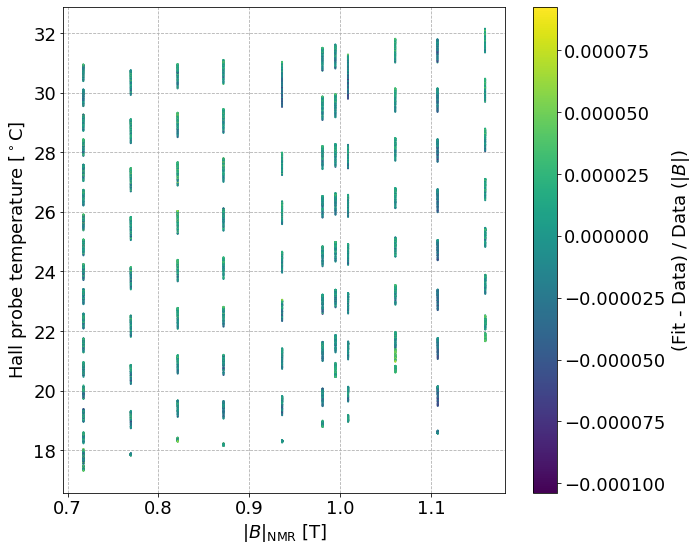

In [205]:
fig, ax = plt.subplots()
fig.patch.set_facecolor('white')

#sc = ax.scatter(df_run['NMR [T]'], df_run[f'{probe}_Cal_T'], s=10, c=res_rel)
sc = ax.scatter(df_run['B_scaled'], df_run[f'{probe}_Cal_T'], s=1, c=res_rel)
cb = fig.colorbar(sc, label=r'(Fit - Data) / Data ($|B|$)')

ax.set_xlabel(r'$|B|_\mathrm{NMR}$ [T]')
ax.set_ylabel(r'Hall probe temperature [$^\circ$C]');
fig.tight_layout()
fig.savefig(plotdir+'cheb_fit_B_res_vs_T_B.png')
fig.savefig(plotdir+'cheb_fit_B_res_vs_T_B.pdf')

In [206]:
fig = scatter3d(df_run['B_scaled'], df_run[f'{probe}_Cal_T'], res_rel_pd, inline=True, show_plot=False)
fig.update_layout(height=700, width=1000)
fig.write_image(plotdir+'B_residual_vs_B_T_plotly.png')
fig.write_image(plotdir+'B_residual_vs_B_T_plotly.pdf')
fig

In [207]:
fig = histo(res_pd, bins=100, show_plot=False)
fig.add_traces([go.Scatter(x=[-1e-4, -1e-4], y=[0, 800], mode='lines', line=dict(color='red', dash='dash'), name='1e-4')])
fig.add_traces([go.Scatter(x=[1e-4, 1e-4], y=[0, 800], mode='lines', line=dict(color='red', dash='dash'), name='')])
fig.update_layout(height=700, width=1000)

In [208]:
fig = histo(res_rel_pd, bins=75, show_plot=False)
fig.add_traces([go.Scatter(x=[-1e-4, -1e-4], y=[0, 450], mode='lines', line=dict(color='red', dash='dash'), name='1e-4')])
fig.add_traces([go.Scatter(x=[1e-4, 1e-4], y=[0, 450], mode='lines', line=dict(color='red', dash='dash'), name='')])
#fig.update_layout(height=700, width=1000)
fig.update_layout(height=700, width=1200)
fig.update_xaxes(range=[-1.25e-4, +1.25e-4])
fig.write_image(plotdir+'B_residual_histo.png')
fig.write_image(plotdir+'B_residual_histo.pdf')
fig

In [209]:
fig = histo(res_rel_pd, bins=75, show_plot=False)
fig.add_traces([go.Scatter(x=[-1e-4, -1e-4], y=[0, 450], mode='lines', line=dict(color='red', dash='dash'), name='1e-4')])
fig.add_traces([go.Scatter(x=[1e-4, 1e-4], y=[0, 450], mode='lines', line=dict(color='red', dash='dash'), name='')])
#fig.update_layout(height=700, width=1000)
fig.update_layout(height=700, width=1200)
fig.update_yaxes(type='log')
fig.update_xaxes(range=[-1.25e-4, +1.25e-4])
fig.write_image(plotdir+'B_residual_histo_log.png')
fig.write_image(plotdir+'B_residual_histo_log.pdf')
fig

In [210]:
# FULL df

In [211]:
res = df_run_full['B_fit'] - df_run_full['B_scaled']
res_pd = pd.Series(res, name='Residuals [T]')
res_rel = (df_run_full['B_fit'] - df_run_full['B_scaled']) / df_run_full['B_scaled']
res_rel_pd = pd.Series(res_rel, name='Relative Residuals')

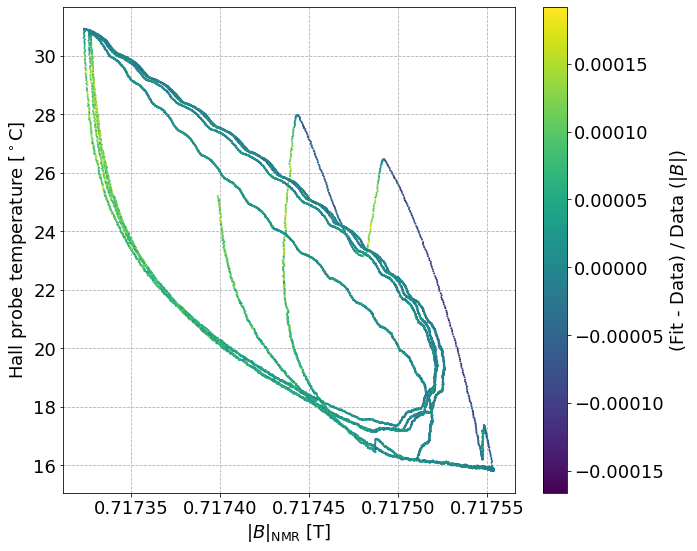

In [212]:
fig, ax = plt.subplots()

#sc = ax.scatter(df_run['NMR [T]'], df_run[f'{probe}_Cal_T'], s=10, c=res_rel)
sc = ax.scatter(df_run_full['B_scaled'], df_run_full[f'{probe}_Cal_T'], s=1, c=res_rel)
cb = fig.colorbar(sc, label=r'(Fit - Data) / Data ($|B|$)')

ax.set_xlabel(r'$|B|_\mathrm{NMR}$ [T]')
ax.set_ylabel(r'Hall probe temperature [$^\circ$C]');
fig.patch.set_facecolor('white')
fig.tight_layout()
fig.savefig(plotdir+'fast_temp_B_res_vs_T_B.png')
fig.savefig(plotdir+'fast_temp_B_res_vs_T_B.pdf')

In [213]:
fig = scatter3d(df_run_full['B_scaled'], df_run_full[f'{probe}_Cal_T'], res_rel_pd, inline=True, show_plot=False)
fig.update_layout(height=700, width=1000)
fig.write_image(plotdir+'fast_temp_B_residual_vs_B_T_plotly.png')
fig.write_image(plotdir+'fast_temp_B_residual_vs_B_T_plotly.pdf')
fig

In [214]:
fig = histo(res_pd, bins=100, show_plot=False)
fig.update_layout(height=700, width=1000)
fig.add_traces([go.Scatter(x=[-1e-4, -1e-4], y=[0, 800], mode='lines', line=dict(color='red', dash='dash'), name='1e-4')])
fig.add_traces([go.Scatter(x=[1e-4, 1e-4], y=[0, 800], mode='lines', line=dict(color='red', dash='dash'), name='')])
# fig.update_xaxes(range=[-1.25e-4, +1.25e-4])
fig.write_image(plotdir+'fast_temp_B_residual_histo.png')
fig.write_image(plotdir+'fast_temp_B_residual_histo.pdf')
fig

In [215]:
fig = histo(res_rel_pd, bins=75, show_plot=False)
fig.add_traces([go.Scatter(x=[-1e-4, -1e-4], y=[0, 1000], mode='lines', line=dict(color='red', dash='dash'), name='1e-4')])
fig.add_traces([go.Scatter(x=[1e-4, 1e-4], y=[0, 1000], mode='lines', line=dict(color='red', dash='dash'), name='')])
fig.update_layout(height=700, width=1000)
# fig.update_xaxes(range=[-1.25e-4, +1.25e-4])
fig.update_yaxes(type='log')
fig.write_image(plotdir+'fast_temp_B_residual_histo_log.png')
fig.write_image(plotdir+'fast_temp_B_residual_histo_log.pdf')
fig

In [216]:
d = df_run_full[f'{probe}_Cal_T'].diff()/(df_run_full['seconds_delta'].diff() / 60.)

Text(0, 0.5, '(Fit - Data) / Data for |B|')

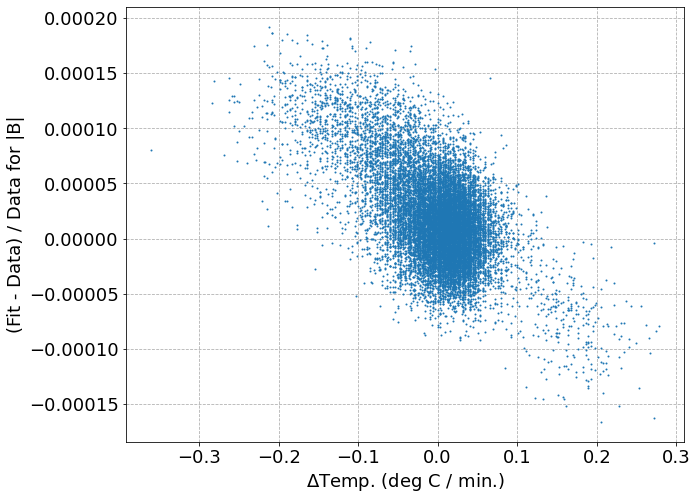

In [217]:
fig, ax = plt.subplots()
ax.scatter(d, res_rel, s=1)
ax.set_xlabel(r'$\Delta$Temp. (deg C / min.)')
ax.set_ylabel('(Fit - Data) / Data for |B|')

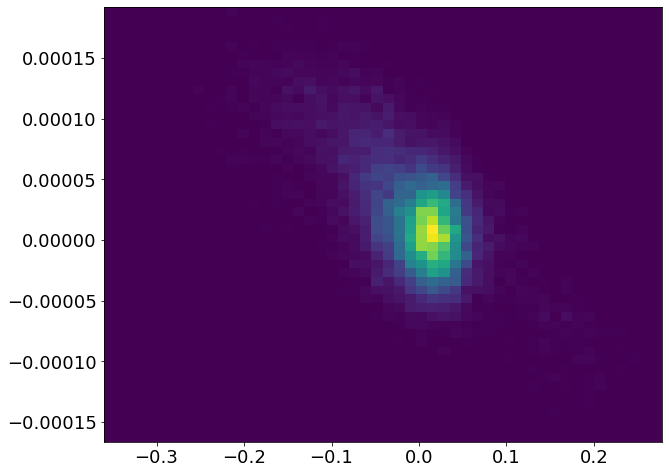

In [218]:
fig, ax = plt.subplots()
ax.hist2d(d[~np.isnan(d)], res_rel[~np.isnan(d)], bins=50);

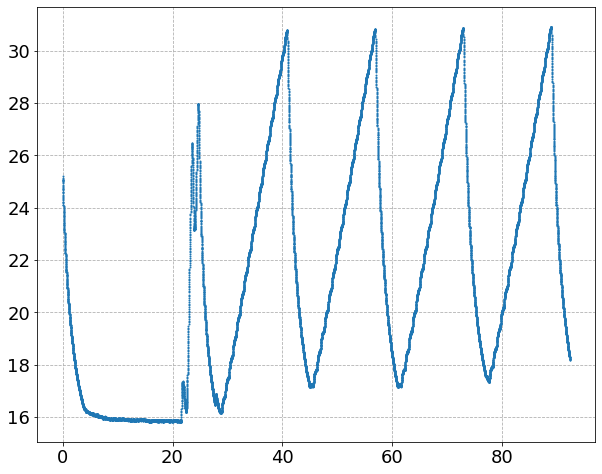

In [219]:
fig, ax = plt.subplots()
ax.scatter(df_run_full['hours_delta'], df_run_full[f'{probe}_Cal_T'], s=1)

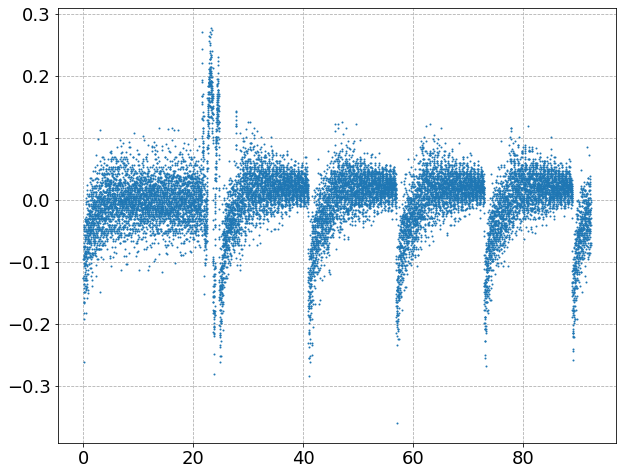

In [220]:
fig, ax = plt.subplots()
ax.scatter(df_run_full['hours_delta'], d, s=1)

In [221]:
# look at only stable temperature
# ensure slow temp changes

In [222]:
#i = np.where(np.isclose(df_run_full['hours_delta'], 29., rtol=1e-3, atol=1e-3))[0][0]
# i = np.where(np.abs(d) <= 0.1)
i = np.where((d <= 0.1) & (d >= -0.02))

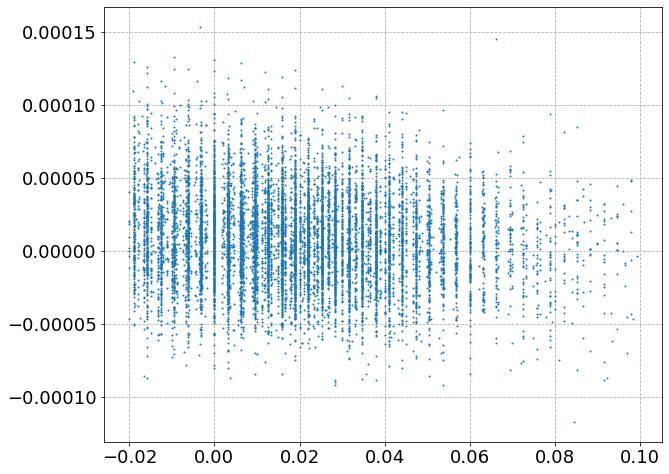

In [223]:
fig, ax = plt.subplots()
# ax.scatter(d[i:], res_rel[i:], s=1)
ax.scatter(d.values[i], res_rel.values[i], s=1)

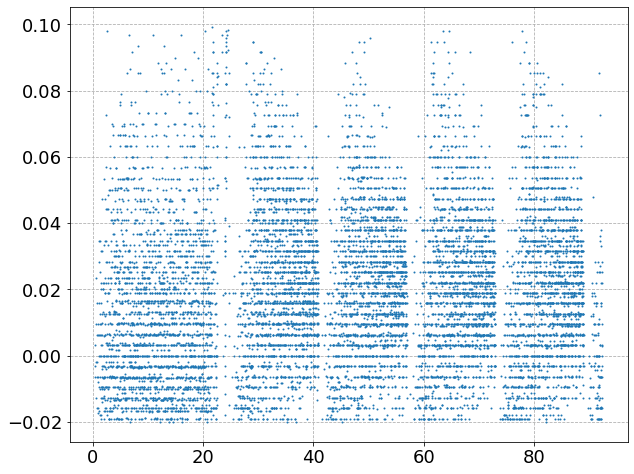

In [224]:
fig, ax = plt.subplots()
ax.scatter(df_run_full['hours_delta'].values[i], d.values[i], s=1)

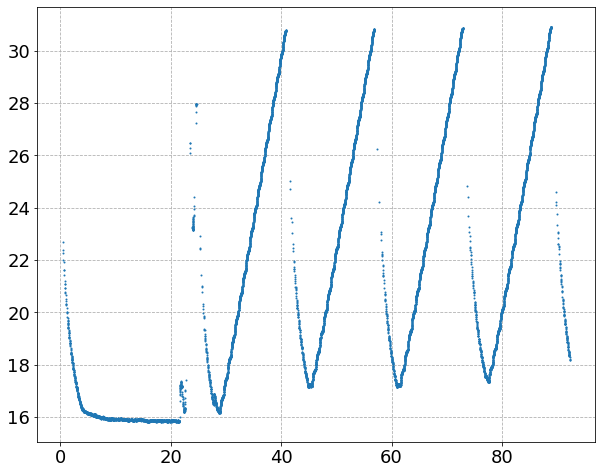

In [225]:
fig, ax = plt.subplots()
# ax.scatter(df_run_full['hours_delta'].iloc[i:], df_run_full[f'{probe}_Cal_T'].iloc[i:], s=1)
ax.scatter(df_run_full['hours_delta'].iloc[i], df_run_full[f'{probe}_Cal_T'].iloc[i], s=1)

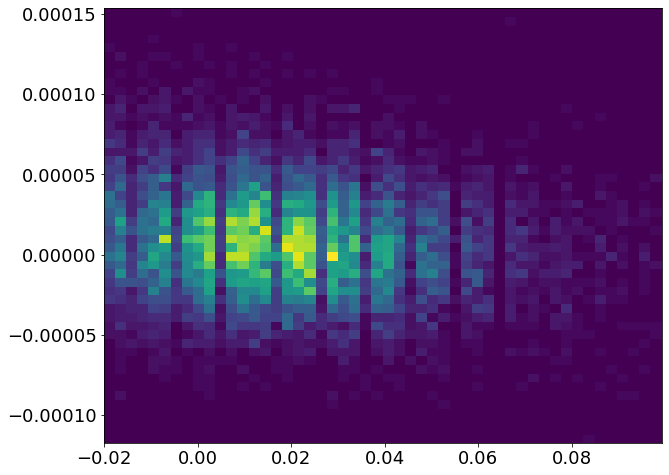

In [226]:
fig, ax = plt.subplots()
# ax.hist2d(d[i:], res_rel[i:], bins=50);
ax.hist2d(d.values[i], res_rel.values[i], bins=50);

In [227]:
res_rel_pd.name

'Relative Residuals'

In [228]:
_ = pd.Series(res_rel_pd.values[i], name='Relative Residuals')
fig = histo(_, bins=75, show_plot=False)
fig.add_traces([go.Scatter(x=[-1e-4, -1e-4], y=[0, 1000], mode='lines', line=dict(color='red', dash='dash'), name='1e-4')])
fig.add_traces([go.Scatter(x=[1e-4, 1e-4], y=[0, 1000], mode='lines', line=dict(color='red', dash='dash'), name='')])
fig.update_layout(height=700, width=1000)
# fig.update_xaxes(range=[-1.25e-4, +1.25e-4])

In [229]:
## Check Bergsma calibration on fit dataset

In [230]:
# FIT df

In [231]:
df_run_ = df_run.copy()
# df_run_ = df_run.query(f'`{probe}_Cal_T` >= 20.').copy()

In [232]:
df_run_[f'{probe}_Cal_T'].describe()

count    9275.000000
mean       24.415876
std         4.050539
min        17.315000
25%        21.053000
50%        24.235000
75%        27.880000
max        32.142000
Name: 2F0000000D5EC73A_Cal_T, dtype: float64

In [233]:
# original
# res = df_run_[f'{probe}_Cal_Bmag'] - df_run_['NMR [T]']
# res_pd = pd.Series(res, name='Residuals [T]')
# res_rel = (df_run_[f'{probe}_Cal_Bmag'] - df_run_['NMR [T]']) / df_run_['NMR [T]']
# res_rel_pd = pd.Series(res_rel, name='Relative Residuals (|B|_Bergsma - |B|_NMR) / |B|_NMR')

In [234]:
# key: "Bcomp" (raw), value: [meaning in Bergsma cal, scaling in Bergsma cal (+-1)
Bergsma_dict = {'Bmag':['Bmag', 1.], 'X': ['Z', -1.], 'Y': ['Y', 1.], 'Z': ['X', 1.]} # from my phase addition
# Bergsma_dict = {'Bmag':['Bmag', 1.], 'X': ['Z', -1.], 'Y': ['Y', 1.], 'Z': ['X', -1.]} # from Raw voltage

In [235]:
df_run_[f'{probe}_Cal_X']

Datetime
2021-07-25 09:22:07    0.714904
2021-07-25 09:22:34    0.714950
2021-07-25 09:22:53    0.714921
2021-07-25 09:23:12    0.714924
2021-07-25 09:23:31    0.714907
                         ...   
2021-08-03 01:50:33    1.154667
2021-08-03 01:50:52    1.154684
2021-08-03 01:51:11    1.154678
2021-08-03 01:51:30    1.154674
2021-08-03 01:51:50    1.154638
Name: 2F0000000D5EC73A_Cal_X, Length: 9275, dtype: float64

In [236]:
comp_bergsma = Bergsma_dict[Bcomp][0]
sf = Bergsma_dict[Bcomp][1]
res = sf*df_run_[f'{probe}_Cal_{comp_bergsma}'] - df_run_['B_scaled']
res_pd = pd.Series(res, name='Residuals [T]')
res_rel = (sf*df_run_[f'{probe}_Cal_{comp_bergsma}'] - df_run_['B_scaled']) / df_run_['B_scaled']
res_rel_pd = pd.Series(res_rel, name='Relative Residuals (|B|_Bergsma - |B|_NMR) / |B|_NMR')

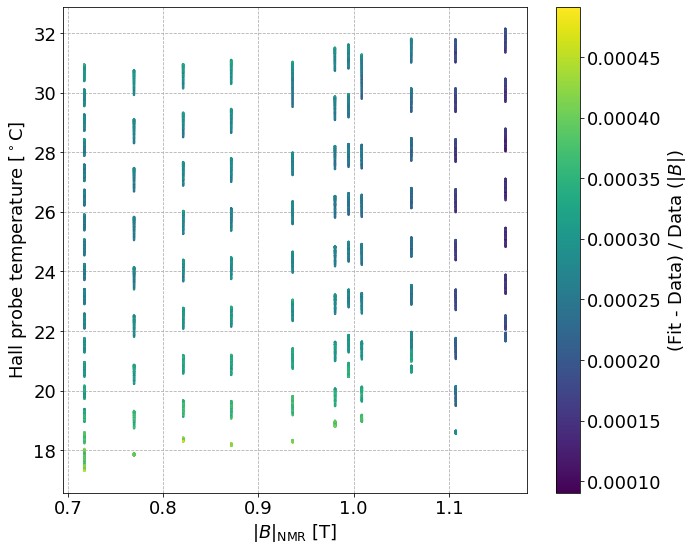

In [237]:
fig, ax = plt.subplots()

#sc = ax.scatter(df_run['NMR [T]'], df_run[f'{probe}_Cal_T'], s=10, c=res_rel)
sc = ax.scatter(df_run_['NMR [T]'], df_run_[f'{probe}_Cal_T'], s=2, c=res_rel)
cb = fig.colorbar(sc, label=r'(Fit - Data) / Data ($|B|$)')

ax.set_xlabel(r'$|B|_\mathrm{NMR}$ [T]')
ax.set_ylabel(r'Hall probe temperature [$^\circ$C]');
fig.patch.set_facecolor('white')
fig.tight_layout()
fig.savefig(plotdir+'Bergsma_B_res_vs_T_B.png')
fig.savefig(plotdir+'Bergsma_B_res_vs_T_B.pdf')

In [238]:
fig = scatter3d(df_run_['NMR [T]'], df_run_[f'{probe}_Cal_T'], res_rel_pd, inline=True, show_plot=False)
fig.update_layout(height=700, width=1000)
fig.write_image(plotdir+'Bergsma_B_residual_vs_B_T_plotly.png')
fig.write_image(plotdir+'Bergsma_B_residual_vs_B_T_plotly.pdf')
fig

In [239]:
# fig = scatter3d(df_run_['NMR [T]'], df_run_[f'{probe}_Cal_T'], res_rel_pd, inline=True, show_plot=False)
# fig.update_layout(height=700, width=1000)
# plot(fig)

In [240]:
fig = histo(res_pd, bins=100, show_plot=False)
fig.update_layout(height=700, width=1000)

In [241]:
fig = histo(res_rel_pd, bins=75, show_plot=False)
fig.add_traces([go.Scatter(x=[-1e-4, -1e-4], y=[0, 450], mode='lines', line=dict(color='red', dash='dash'), name='1e-4')])
fig.add_traces([go.Scatter(x=[1e-4, 1e-4], y=[0, 450], mode='lines', line=dict(color='red', dash='dash'), name='')])
# fig.update_layout(height=700, width=1000)
fig.update_layout(height=700, width=1200)
fig.update_xaxes(range=[-1.25e-4, +5.25e-4])
fig.write_image(plotdir+'Bergsma_B_residual_histo.png')
fig.write_image(plotdir+'Bergsma_B_residual_histo.pdf')
fig

In [242]:
fig = histo(res_rel_pd, bins=75, show_plot=False)
fig.add_traces([go.Scatter(x=[-1e-4, -1e-4], y=[0, 450], mode='lines', line=dict(color='red', dash='dash'), name='1e-4')])
fig.add_traces([go.Scatter(x=[1e-4, 1e-4], y=[0, 450], mode='lines', line=dict(color='red', dash='dash'), name='')])
# fig.update_layout(height=700, width=1000)
fig.update_layout(height=700, width=1200)
fig.update_xaxes(range=[-1.25e-4, +5.25e-4])
fig.update_yaxes(type='log')
fig.write_image(plotdir+'Bergsma_B_residual_histo_log.png')
fig.write_image(plotdir+'Bergsma_B_residual_histo_log.pdf')
fig

# Plots for FMS

In [243]:
probe

'2F0000000D5EC73A'

In [244]:
# combine my calibration with Bergsma calibration

In [245]:
# FIT df

In [246]:
# my fit
res = df_run['B_fit'] - df_run['NMR [T]']
res_pd = pd.Series(res, name='Residuals [T] (Kampa)')
res_rel = (df_run['B_fit'] - df_run['NMR [T]']) / df_run['NMR [T]']
res_rel_pd = pd.Series(res_rel, name='Relative Residuals (|B|_Fit - |B|_NMR) / |B|_NMR (Kampa)')
# bergsma
res_B = df_run_[f'{probe}_Cal_Bmag'] - df_run_['NMR [T]']
res_pd_B = pd.Series(res_B, name='Residuals [T] (Bergsma)')
res_rel_B = (df_run_[f'{probe}_Cal_Bmag'] - df_run_['NMR [T]']) / df_run_['NMR [T]']
res_rel_pd_B = pd.Series(res_rel_B, name='Relative Residuals (|B|_Bergsma - |B|_NMR) / |B|_NMR (Bergsma)')

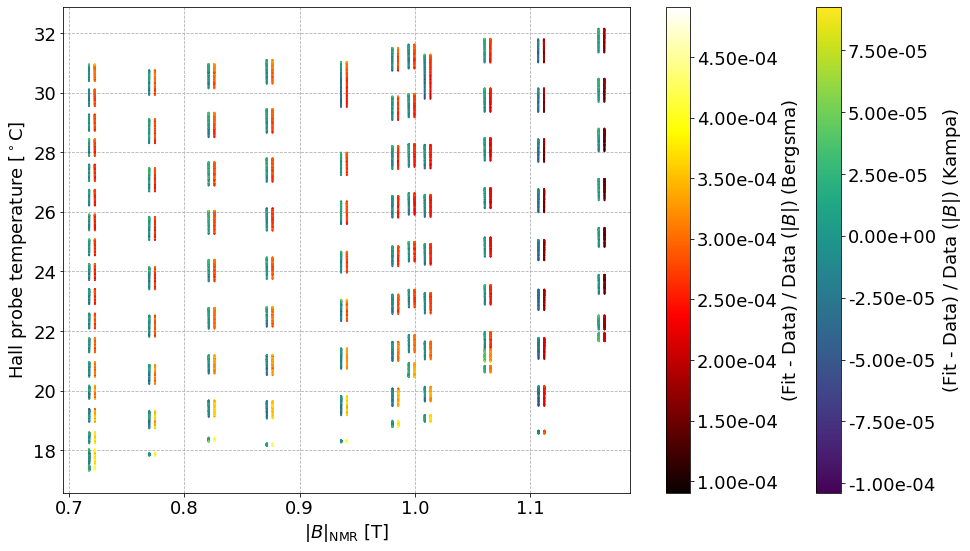

In [247]:
fig, ax = plt.subplots(figsize=(14, 8))

#sc = ax.scatter(df_run['NMR [T]'], df_run[f'{probe}_Cal_T'], s=10, c=res_rel)
sc = ax.scatter(df_run['NMR [T]'], df_run[f'{probe}_Cal_T'], s=1, c=res_rel)
cb = fig.colorbar(sc, label=r'(Fit - Data) / Data ($|B|$) (Kampa)', format='%0.2e')

# SLIGHT OFFSET FOR BERGSMA IN B
sc2 = ax.scatter(df_run['NMR [T]']+5e-3, df_run[f'{probe}_Cal_T'], s=1, c=res_rel_B, cmap='hot')
#cb2 = fig.colorbar(sc2, label=r'(Fit - Data) / Data ($|B|$) (Bergsma)')
cb2 = fig.colorbar(sc2, format='%0.2e')
cb2.set_label(r'(Fit - Data) / Data ($|B|$) (Bergsma)', labelpad=2)

ax.set_xlabel(r'$|B|_\mathrm{NMR}$ [T]')
ax.set_ylabel(r'Hall probe temperature [$^\circ$C]');
fig.patch.set_facecolor('white')
fig.tight_layout()
fig.savefig(plotdir+'both_B_res_vs_T_B.png')
fig.savefig(plotdir+'both_B_res_vs_T_B.pdf')

In [248]:
fig = scatter3d(2*[df_run['NMR [T]']], 2*[df_run[f'{probe}_Cal_T']], [res_rel_pd, res_rel_pd_B],  units_list=2*[('', 'deg C', '')], colors_list=['viridis', 'hot'],
                inline=True, show_plot=False)
fig.update_layout(height=700, width=1000)
fig.write_image(plotdir+'both_B_residual_vs_B_T_plotly.png')
fig.write_image(plotdir+'both_B_residual_vs_B_T_plotly.pdf')
fig

In [249]:
fig = histo([res_pd, res_pd_B], bins=100, same_bins=True, autobin=False, show_plot=False)
fig.update_layout(height=700, width=1000)

In [250]:
fig = histo([res_rel_pd, res_rel_pd_B], bins=100, same_bins=True, autobin=False, show_plot=False)

fig.add_traces([go.Scatter(x=[-1e-4, -1e-4], y=[0, 900], mode='lines', line=dict(color='red', dash='dash'), name='1e-4')])
fig.add_traces([go.Scatter(x=[1e-4, 1e-4], y=[0, 900], mode='lines', line=dict(color='red', dash='dash'), name='')])
#fig.update_layout(height=700, width=1000)
fig.update_layout(height=700, width=1200)
#fig.update_xaxes(range=[-1.25e-4, +1.25e-4])
# fig.update_yaxes(type='log')
fig.write_image(plotdir+'both_B_residual_histo.png')
fig.write_image(plotdir+'both_B_residual_histo.pdf')
fig

In [251]:
fig = histo([res_rel_pd, res_rel_pd_B], bins=100, same_bins=True, autobin=False, show_plot=False)

fig.add_traces([go.Scatter(x=[-1e-4, -1e-4], y=[0, 900], mode='lines', line=dict(color='red', dash='dash'), name='1e-4')])
fig.add_traces([go.Scatter(x=[1e-4, 1e-4], y=[0, 900], mode='lines', line=dict(color='red', dash='dash'), name='')])
#fig.update_layout(height=700, width=1000)
fig.update_layout(height=700, width=1200)
#fig.update_xaxes(range=[-1.25e-4, +1.25e-4])
fig.update_yaxes(type='log')
fig.write_image(plotdir+'both_B_residual_histo_log.png')
fig.write_image(plotdir+'both_B_residual_histo_log.pdf')
fig

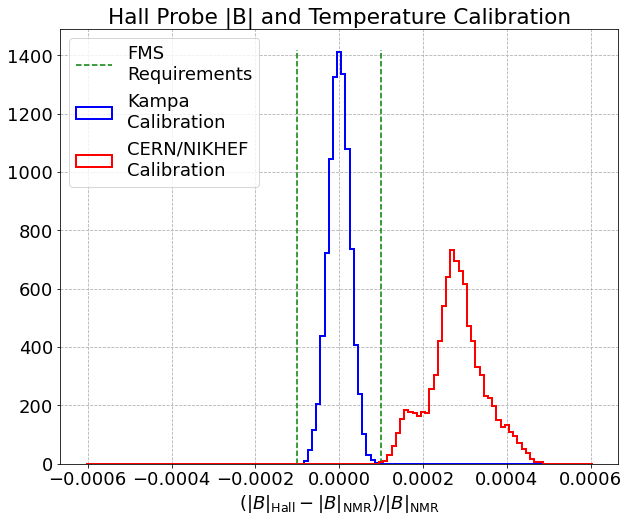

In [265]:
# 2024-08-26 13:17:15 repeat above plot in matplotlib, for DOE proposal
# square plot
fig, ax = plt.subplots(figsize=(10,8))
# fig, ax = plt.subplots(figsize=10,8)

bins = np.arange(-6.05e-4, 6.05e-4+1e-5, 1e-5)

ax.hist(res_rel_pd, bins=bins, histtype='step', color='blue', linewidth=2, label='Kampa\nCalibration', zorder=3)
ax.hist(res_rel_pd_B, bins=bins, histtype='step', color='red', linewidth=2, label='CERN/NIKHEF\nCalibration', zorder=3)

ax.plot([-1e-4, -1e-4], [0, 1420], 'g--', label='FMS\nRequirements')
ax.plot([1e-4, 1e-4], [0, 1420], 'g--')
ax.legend(loc='upper left')

ax.set_xlabel(r'$(|B|_{\mathrm{Hall}} - |B|_{\mathrm{NMR}}) / |B|_{\mathrm{NMR}}$')
ax.set_title('Hall Probe |B| and Temperature Calibration')
fig.savefig(plotdir+'both_B_residual_histo_mpl.png')
fig.savefig(plotdir+'both_B_residual_histo_mpl.pdf')

# Magnet Locations

- Determining offset / where to put Zaber for V vs. B, temp and also for pole-to-pole, for low range NMR taped on top of Zaber

In [483]:
# mm offsets, in magnet coordinates
# delta = low field NMR position - high field NMR position
delta_X = -3.88
delta_Y = 0
delta_Z = 21.01

In [484]:
mm_per_ADC

0.000390625

In [485]:
ADC_per_mm

2560.0

In [487]:
-delta_X * ADC_per_mm

9932.8

- Cannot actually put x closer, so just calculate new Y, Z
- Y is not offset so only Z

In [488]:
delta_Z * ADC_per_mm

53785.600000000006

- Add this number to Z ADC (since Z increases ADC as it goes towards the floor)

In [494]:
X_hi = 463412 # by hand limit from before low field NMR was installed
X_lo = 459413 # by hand put limit
Y_hi = 424673
Y_lo = Y_hi
Z_hi = 1675120
Z_lo = Z_hi + delta_Z * ADC_per_mm

In [495]:
Z_lo

1728905.6

In [497]:
(Z_lo - 1710750) * mm_per_ADC

7.092031250000037

In [491]:
(X_lo-X_hi) * mm_per_ADC

-1.5621093750000001

In [492]:
delta_X

-3.88

In [493]:
(X_lo-X_hi) * mm_per_ADC + delta_X

-5.442109375

In [ ]:
new_Z

In [499]:
delta_Z * ADC_per_mm

53785.600000000006

In [500]:
delta_Z

21.01

In [501]:
# pole to pole
1649035 + delta_Z * ADC_per_mm

1702820.6

In [504]:
delta_X

-3.88

In [503]:
delta_X * ADC_per_mm

-9932.8

In [505]:
422190-delta_X * ADC_per_mm

432122.8

In [506]:
delta_X * ADC_per_mm

-9932.8

# Checking Location
- order 4 polynomial in excel spreadsheet for pole-to-pole 420k
- find X (ADC) @ minimum for each. distance apart should give a good idea of any X offset

In [ ]:
# low
# y = -3.043609E-24x4 + 6.007228E-18x3 - 4.402498E-12x2 + 1.419257E-06x + 6.010490E-01
# high
#y = -2.401689E-24x4 + 4.732538E-18x3 - 3.457484E-12x2 + 1.109276E-06x + 6.389832E-01

In [510]:
coeffs_low = np.array([6.010490E-01, 1.419257E-06, -4.402498E-12, 6.007228E-18, -3.043609E-24])[::-1]
coeffs_high = np.array([6.389832E-01, 1.109276E-06, -3.457484E-12, 4.732538E-18, -2.401689E-24])[::-1]
poly_low = np.poly1d(coeffs_low)
poly_high = np.poly1d(coeffs_high)

In [517]:
xs = np.arange(420000, 545000, 1)
ys_low = poly_low(xs)
ys_high = poly_high(xs)

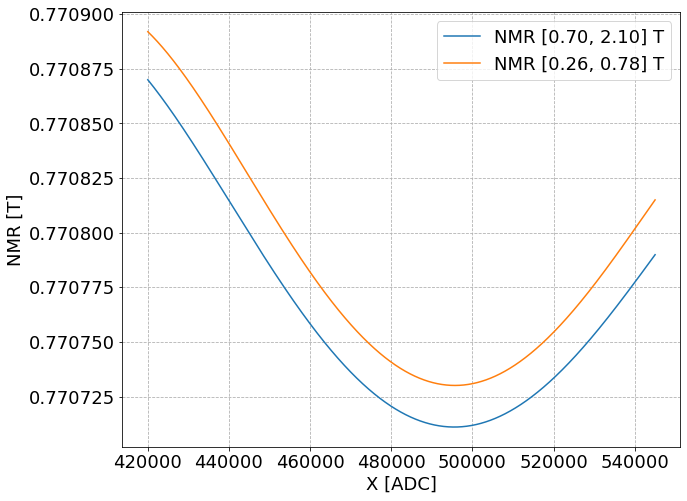

In [520]:
fig, ax = plt.subplots()
ax.plot(xs, ys_high, label='NMR [0.70, 2.10] T')
ax.plot(xs, ys_low, label='NMR [0.26, 0.78] T')
ax.set_xlabel('X [ADC]')
ax.set_ylabel('NMR [T]')
ax.legend();

In [515]:
poly_low(440000)-poly_high(440000)

2.6144716800069467e-05

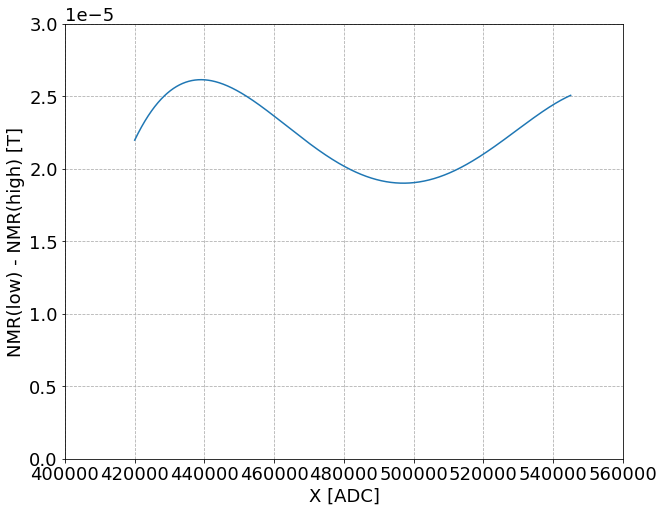

In [523]:
fig, ax = plt.subplots()
ax.plot(xs, ys_low-ys_high)#, label='NMR [0.70, 2.10] T')
# ax.plot(xs, ys_low, label='NMR [0.26, 0.78] T')
ax.set_xlabel('X [ADC]')
ax.set_ylabel('NMR(low) - NMR(high) [T]')
ax.set_xlim([400000, 560000])
ax.set_ylim([0, 3e-5]);
# ax.legend();

In [525]:
x0_low = xs[ys_low.argmin()]
x0_high = xs[ys_high.argmin()]

In [526]:
x0_low - x0_high

149

In [527]:
(x0_low - x0_high) * mm_per_ADC

0.058203125

In [528]:
xs[ys_low.argmin()]

495668

In [530]:
ADC_to_mm(xs[ys_low.argmin()], 'X')

39.60234375

In [531]:
ADC_to_mm(xs[ys_low.argmin()], 'X') * 2

79.2046875

In [532]:
# try correcting and look at the residuals

In [537]:
xs = np.arange(420000, 545000, 1)
ys_low = poly_low(xs-(x0_low - x0_high))
ys_high = poly_high(xs)

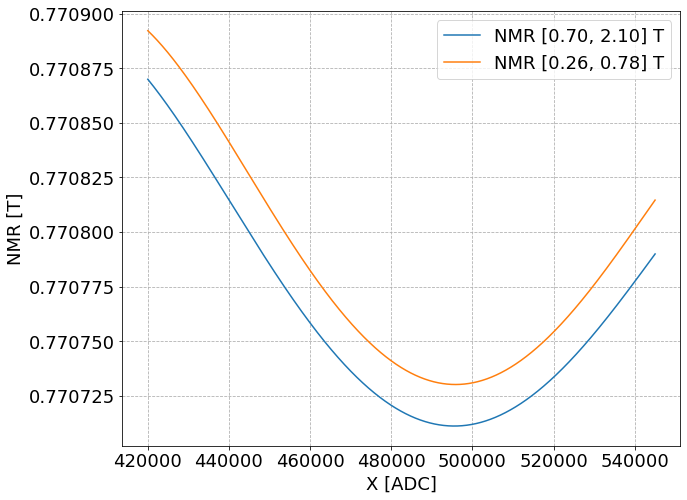

In [538]:
fig, ax = plt.subplots()
ax.plot(xs, ys_high, label='NMR [0.70, 2.10] T')
ax.plot(xs, ys_low, label='NMR [0.26, 0.78] T')
ax.set_xlabel('X [ADC]')
ax.set_ylabel('NMR [T]')
ax.legend();

In [541]:
poly_low(440000)-poly_high(440000)

2.6144716800069467e-05

In [542]:
(x0_low - x0_high)

149

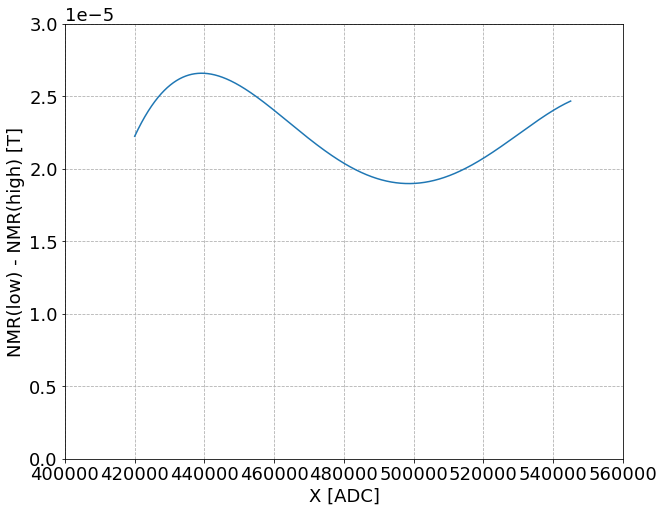

In [543]:
fig, ax = plt.subplots()
ax.plot(xs, ys_low-ys_high)#, label='NMR [0.70, 2.10] T')
# ax.plot(xs, ys_low, label='NMR [0.26, 0.78] T')
ax.set_xlabel('X [ADC]')
ax.set_ylabel('NMR(low) - NMR(high) [T]')
ax.set_xlim([400000, 560000])
ax.set_ylim([0, 3e-5]);
# ax.legend();